In [ ]:
!python --version

Python 3.10.12


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab.data_table import DataTable
DataTable.max_columns = 30
train_df = pd.read_csv('DataTable_CDs.csv', dtype={'precursor_2_g':float, 'power_W':float, 'QY_red_%':float, 'temperature_°C':float})
train_df = train_df.replace('', np.nan)

train_df = train_df.set_index(pd.Index(range(1, len(train_df) + 1)))

In [ ]:
train_df

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,10.1002/smll.201905050,ST,CA,urea,NaN,DMF,2.000,4.000,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
2,10.1038/s41377-018-0090-1,ST,CA,urea,NaN,DMSO,2.000,6.000,NaN,30.0,NaN,160.0,4.0,650.0,655.0,720,0.20,0.347222,3.333333,NaN
3,10.1002/adma.201603443,HT,Dopamine,o-phenylenediamine,NaN,water,0.184,0.108,NaN,10.0,NaN,200.0,8.0,631.0,540.0,710,26.28,0.120261,0.180000,NaN
4,10.1021/acsabm.1c00121,HT,o-phenylenediamine,urea,NaN,H2SO4/water,0.200,0.130,NaN,30.0,NaN,210.0,8.0,570.0,580.0,650,20.00,0.061728,0.072222,NaN
5,10.1007/s12274-017-1528-0,HT,Polythiophene,diphenyl diselenide,NaN,NAOH/water,0.010,0.010,NaN,15.0,NaN,180.0,24.0,526.0,680.0,820,0.20,0.007937,0.002137,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,10.3390/ma14164716,ST,1_4-diaminonaphthalene,NaN,NaN,DMF,0.100,NaN,NaN,10.0,NaN,180.0,10.0,567.0,NaN,605,7.50,0.063291,NaN,NaN
123,10.1007/s00604-022-05543-8,ST,3_4-diaminobenzoic acid,NaN,NaN,HCl/water,0.100,NaN,NaN,10.0,NaN,200.0,10.0,540.0,NaN,610,19.70,0.065789,NaN,NaN
124,10.1007/s00604-020-04316-5,ST,p-phenylenediamine,NaN,NaN,toluene,0.100,NaN,NaN,10.0,NaN,185.0,5.0,490.0,440.0,610,18.20,0.092593,NaN,NaN
125,10.1007/s00216-018-1547-z,ST,o-phenylenediamine,NaN,NaN,HCl/water,0.027,NaN,NaN,5.0,NaN,150.0,8.0,NaN,560.0,620,12.80,0.050000,NaN,NaN


In [ ]:
train_df.describe() #data of different scales (determined by the maximum parameter)

,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
count,126.000000,86.000000,11.000000,126.000000,7.0,122.000000,123.000000,122.000000,104.000000,126.000000,106.000000,126.000000,86.000000,10.000000
mean,0.993902,1.627169,0.858909,26.463968,600.0,177.090164,8.254146,562.352459,554.798077,643.079365,21.503113,0.464509,1.779392,1.251234
std,1.459822,1.879961,1.033619,27.823366,200.0,26.102469,11.487494,79.692998,65.401134,45.786217,16.459776,2.131952,4.034086,2.389137
min,0.010000,0.002100,0.080000,0.260000,300.0,25.000000,0.017000,300.000000,375.000000,580.000000,0.200000,0.000765,0.000717,0.013258
25%,0.100000,0.105750,0.222500,10.000000,450.0,160.000000,4.000000,526.500000,531.500000,610.000000,10.255000,0.050413,0.082280,0.140921
50%,0.600000,0.795000,0.430000,20.000000,700.0,180.000000,6.000000,550.000000,550.000000,630.000000,17.350000,0.102083,0.393750,0.258270
75%,1.200000,2.000000,0.900000,30.000000,750.0,200.000000,10.000000,600.000000,580.000000,657.000000,26.445000,0.520833,3.313333,0.263514
max,10.000000,6.700000,3.500000,200.000000,800.0,240.000000,120.000000,783.000000,732.000000,820.000000,78.300000,23.809524,34.183673,7.183908


In [ ]:
train_df.dtypes

DOI                                 object
type_of_synthesis                   object
precursor_1                         object
precursor_2                         object
precursor_3                         object
reagent                             object
precursor_1_g                      float64
precursor_2_g                      float64
precursor_3_g                      float64
reagent_mL                         float64
power_W                            float64
temperature_°C                     float64
time_h                             float64
Abs_red_max_nm                     float64
Exc_red_max_nm                     float64
FL_red_max_nm                        int64
QY_red_%                           float64
molar_concentration_precursor_1    float64
molar_concentration_precursor_2    float64
molar_concentration_precursor_3    float64
dtype: object

In [ ]:
train_df.isna().sum()

DOI                                  0
type_of_synthesis                    2
precursor_1                          0
precursor_2                         40
precursor_3                        115
reagent                              0
precursor_1_g                        0
precursor_2_g                       40
precursor_3_g                      115
reagent_mL                           0
power_W                            119
temperature_°C                       4
time_h                               3
Abs_red_max_nm                       4
Exc_red_max_nm                      22
FL_red_max_nm                        0
QY_red_%                            20
molar_concentration_precursor_1      0
molar_concentration_precursor_2     40
molar_concentration_precursor_3    116
dtype: int64

In [ ]:
#sns.pairplot(train_df);

In [ ]:
train_df_categorical = train_df.select_dtypes(include=['object'])  #description for categories

In [ ]:
train_df_categorical.describe()

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent
count,126,124,126,86,11,126
unique,108,5,39,38,11,27
top,10.3390/ma14164716,ST,CA,urea,NH4F,DMF
freq,5,100,51,29,1,29


In [ ]:
train_df_numerical = train_df.select_dtypes(include=['float64', 'int64'])  #description for numerical features

In [ ]:
train_df_numerical

,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,2.000,4.000,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
2,2.000,6.000,NaN,30.0,NaN,160.0,4.0,650.0,655.0,720,0.20,0.347222,3.333333,NaN
3,0.184,0.108,NaN,10.0,NaN,200.0,8.0,631.0,540.0,710,26.28,0.120261,0.180000,NaN
4,0.200,0.130,NaN,30.0,NaN,210.0,8.0,570.0,580.0,650,20.00,0.061728,0.072222,NaN
5,0.010,0.010,NaN,15.0,NaN,180.0,24.0,526.0,680.0,820,0.20,0.007937,0.002137,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122,0.100,NaN,NaN,10.0,NaN,180.0,10.0,567.0,NaN,605,7.50,0.063291,NaN,NaN
123,0.100,NaN,NaN,10.0,NaN,200.0,10.0,540.0,NaN,610,19.70,0.065789,NaN,NaN
124,0.100,NaN,NaN,10.0,NaN,185.0,5.0,490.0,440.0,610,18.20,0.092593,NaN,NaN
125,0.027,NaN,NaN,5.0,NaN,150.0,8.0,NaN,560.0,620,12.80,0.050000,NaN,NaN


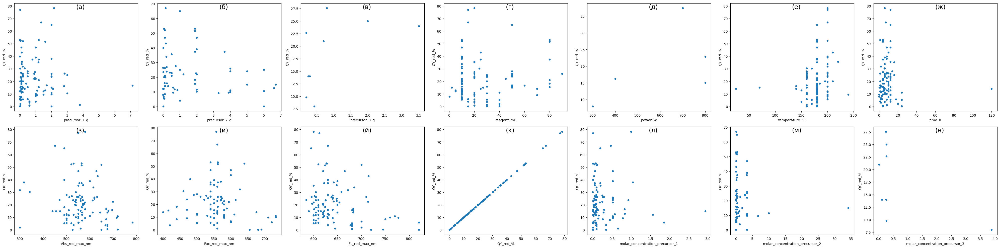

In [ ]:
#fig, axes = plt.subplots(nrows=11, ncols=1,figsize=(10, 70))
#for idx, feature in enumerate(train_df_numerical.columns):
   # train_df_numerical.plot(feature, "FL_red_max_nm", subplots=True, kind="scatter", ax=axes[idx])
#look at the target in the form of luminescence wavelength
#We don’t really see linear dependencies - the dependencies are complex

fig, axes = plt.subplots(nrows=2, ncols=7, figsize=(40, 10))
count = 0
for idx, feature in enumerate(train_df_numerical.columns):
    if count < len(train_df_numerical.columns):
        train_df_numerical.plot(x=feature, y="QY_red_%", kind="scatter", ax=axes[count // 7, count % 7])
        axes[count // 7, count % 7].text(0.5, 0.95, f'({chr(1072 + count)})', transform=axes[count // 7, count % 7].transAxes, fontsize=18)
        count += 1
    else:
        break

plt.tight_layout()
plt.show()



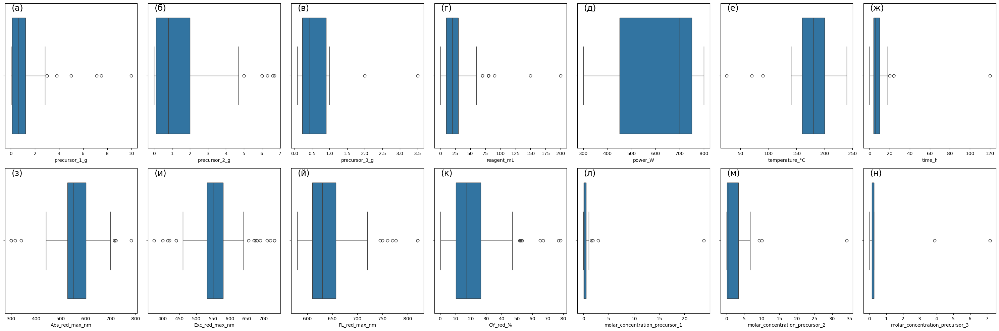

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
#let's look at outliers in features and targets
fig, axes = plt.subplots(nrows=2, ncols=7, figsize=(30, 10))
count = 0
for idx, feature in enumerate(train_df_numerical.columns):
    sns.boxplot(x=train_df_numerical[feature], ax=axes[count // 7, count % 7])
    axes[count // 7, count % 7].text(0.05, 0.95, f'({chr(1072 + count)})', transform=axes[count // 7, count % 7].transAxes, fontsize=18)
    count += 1

plt.tight_layout()
plt.show()

In [ ]:
#display the values of outliers in the data
for feature in train_df_numerical.columns:
    q1 = train_df_numerical[feature].quantile(0.25)
    q3 = train_df_numerical[feature].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outliers = train_df_numerical[(train_df_numerical[feature] < lower_bound) | (train_df_numerical[feature] > upper_bound)][feature]

    print(f"Feature: {feature}, Outliers:")
    print(outliers)
    print("\n")


Feature: precursor_1_g, Outliers:
20     10.00
21      3.00
35      3.00
37      7.50
52      5.00
112     7.12
116     3.80
Name: precursor_1_g, dtype: float64


Feature: precursor_2_g, Outliers:
2      6.0
20     6.3
21     6.0
35     6.0
60     5.0
63     6.6
78     5.0
100    6.7
Name: precursor_2_g, dtype: float64


Feature: precursor_3_g, Outliers:
34    2.0
60    3.5
Name: precursor_3_g, dtype: float64


Feature: reagent_mL, Outliers:
11     80.0
12     80.0
13     80.0
14     80.0
20    200.0
37    150.0
47     70.0
55     70.0
73     80.0
77     80.0
89     90.0
Name: reagent_mL, dtype: float64


Feature: power_W, Outliers:
Series([], Name: power_W, dtype: float64)


Feature: temperature_°C, Outliers:
52     90.0
100    70.0
117    25.0
Name: temperature_°C, dtype: float64


Feature: time_h, Outliers:
5       24.0
27      24.0
44      24.0
90      24.0
98      20.0
101     24.0
117    120.0
Name: time_h, dtype: float64


Feature: Abs_red_max_nm, Outliers:
1      720.0
6      7

In [ ]:
train_dfOUTLIERS=train_df.loc[:, ['FL_red_max_nm', 'Abs_red_max_nm', 'QY_red_%']]
description1=train_df.describe()
description1.loc['median'] = train_dfOUTLIERS.median()




description1

,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
count,126.000000,86.000000,11.000000,126.000000,7.0,122.000000,123.000000,122.000000,104.000000,126.000000,106.000000,126.000000,86.000000,10.000000
mean,0.993902,1.627169,0.858909,26.463968,600.0,177.090164,8.254146,562.352459,554.798077,643.079365,21.503113,0.464509,1.779392,1.251234
std,1.459822,1.879961,1.033619,27.823366,200.0,26.102469,11.487494,79.692998,65.401134,45.786217,16.459776,2.131952,4.034086,2.389137
min,0.010000,0.002100,0.080000,0.260000,300.0,25.000000,0.017000,300.000000,375.000000,580.000000,0.200000,0.000765,0.000717,0.013258
25%,0.100000,0.105750,0.222500,10.000000,450.0,160.000000,4.000000,526.500000,531.500000,610.000000,10.255000,0.050413,0.082280,0.140921
50%,0.600000,0.795000,0.430000,20.000000,700.0,180.000000,6.000000,550.000000,550.000000,630.000000,17.350000,0.102083,0.393750,0.258270
75%,1.200000,2.000000,0.900000,30.000000,750.0,200.000000,10.000000,600.000000,580.000000,657.000000,26.445000,0.520833,3.313333,0.263514
max,10.000000,6.700000,3.500000,200.000000,800.0,240.000000,120.000000,783.000000,732.000000,820.000000,78.300000,23.809524,34.183673,7.183908
median,NaN,NaN,NaN,NaN,NaN,NaN,NaN,550.000000,NaN,630.000000,17.350000,NaN,NaN,NaN


In [ ]:
#Let's create a dataset from the PL, QY and abs wavelengths to look at emissions in the data (we also consider so that the quantum yield is not equal to 0)
train_dfCLASTER= train_df.loc[(train_df['QY_red_%'].notnull())]
X=train_dfCLASTER.loc[:, ['FL_red_max_nm', 'Abs_red_max_nm', 'QY_red_%']] #This example uses iloc to select all rows (indicated by a colon) and then select the columns using a list of indexes

In [ ]:
corrs = train_df[['molar_concentration_precursor_1', 'molar_concentration_precursor_2', 'molar_concentration_precursor_3', 'power_W', 'temperature_°C', 'time_h', 'FL_red_max_nm', 'Abs_red_max_nm', 'QY_red_%','Exc_red_max_nm']].corr(numeric_only=True) #method .corr we calculate the correlation in the dataset
upper_tri = corrs.where(np.triu(np.ones(corrs.shape), k=1).astype(bool)) #the correlation matrix is symmetrical with respect to the diagonal - therefore we do not pay attention to the lower triangle
upper_tri

,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3,power_W,temperature_°C,time_h,FL_red_max_nm,Abs_red_max_nm,QY_red_%,Exc_red_max_nm
molar_concentration_precursor_1,NaN,0.31355,0.878124,-0.783734,-0.351857,-0.060742,-0.000331,-0.017381,-0.028953,0.223085
molar_concentration_precursor_2,NaN,NaN,0.799207,0.238553,-0.433901,-0.132397,-0.107603,-0.183119,-0.116524,0.150047
molar_concentration_precursor_3,NaN,NaN,NaN,NaN,-0.251760,-0.211330,-0.226967,-0.441575,-0.536656,0.445994
power_W,NaN,NaN,NaN,NaN,-0.777714,0.164091,0.174703,-0.031080,0.543424,-0.264232
temperature_°C,NaN,NaN,NaN,NaN,NaN,-0.446068,-0.069901,-0.091179,0.179134,0.055461
time_h,NaN,NaN,NaN,NaN,NaN,NaN,0.046380,0.041932,-0.053608,-0.237220
FL_red_max_nm,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.514821,-0.260777,0.545415
Abs_red_max_nm,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.193250,0.352380
QY_red_%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.087097
Exc_red_max_nm,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


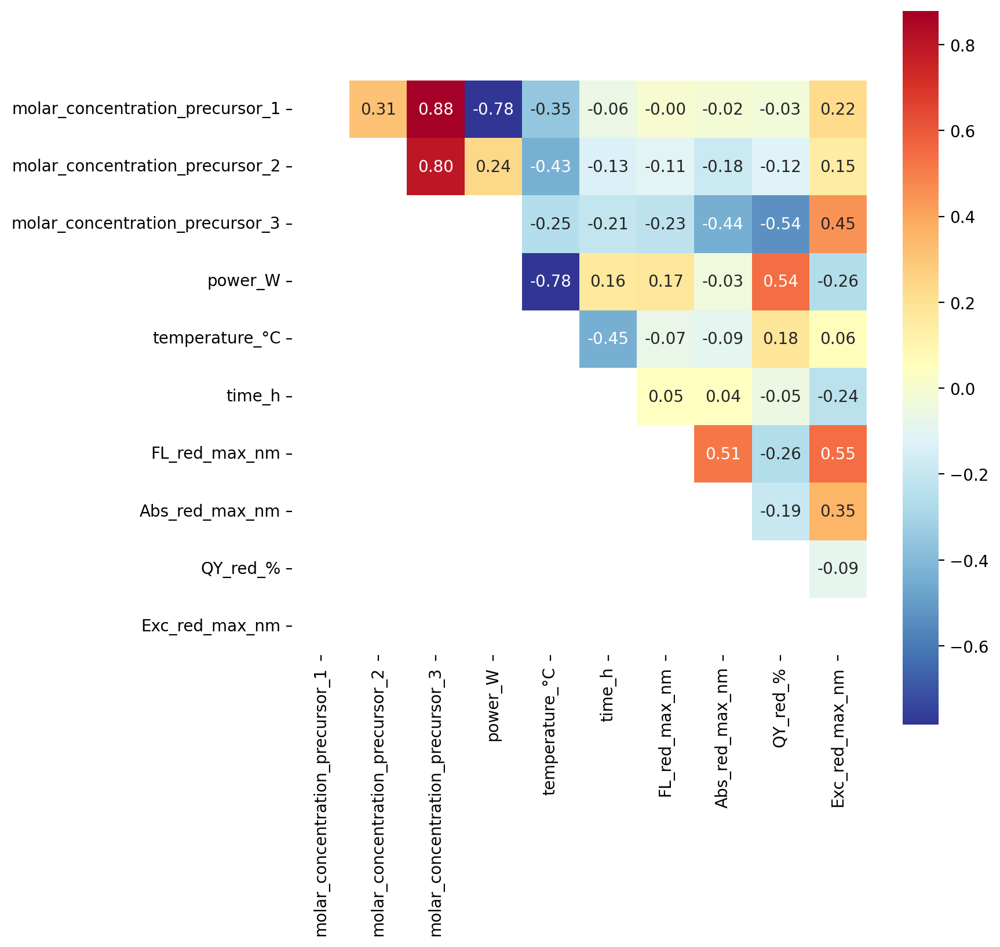

In [ ]:
#build a heatmap on the upper triangle
plt.figure(figsize=(8, 8), dpi=200)
sns.heatmap(upper_tri, cmap="RdYlBu_r", square=True, annot=True, fmt=".2f");

In [ ]:
#let's create a group of syntheses of interest
#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') ]
#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['type_of_synthesis'] == 'ST')]
#new_df = train_df.loc[(train_df['precursor_2'] == 'urea') ]
#new_df = train_df.loc[(train_df['reagent'] == 'DMF') ]
#new_df= train_df.loc[(train_df['reagent'] == 'formamide') ]

#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['reagent'] == 'formamide')]
#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['precursor_2'] == 'urea') &(train_df['reagent'] == 'DMF')]

#1#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['precursor_1'] != 'p-phenylenediamine') & (train_df['precursor_2'] != 'urea') & (train_df['precursor_2'] != 'p-phenylenediamine') & ((train_df['reagent'] == 'formamide') | (train_df['reagent'] == 'DMF'))]
#3#new_df = train_df.loc[(train_df['precursor_1'] != 'CA') & ((train_df['precursor_1'] == 'p-phenylenediamine') | (train_df['precursor_2'] == 'p-phenylenediamine')) & (train_df['precursor_2'] != 'urea') &  ((train_df['reagent'] == 'formamide') | (train_df['reagent'] == 'DMF'))]
#4#new_df = train_df.loc[(train_df['precursor_1'] != 'CA') & (train_df['precursor_1'] != 'p-phenylenediamine') & (train_df['precursor_2'] != 'p-phenylenediamine') & (train_df['precursor_2'] != 'urea') &  (train_df['reagent'] == 'DMF')]

#precursors_condition = train_df['precursor_1'].isin(['CA', 'p-phenylenediamine']) & train_df['precursor_2'].isin(['p-phenylenediamine', 'urea'])
#reagent_condition = train_df['reagent'] == 'formamide'

#5#new_df = train_df.loc[precursors_condition & reagent_condition]

#6#new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['precursor_2'] == 'urea') &(train_df['reagent'] == 'DMF')]


new_df = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['reagent'] == 'formamide')]

In [ ]:
new_df

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
8,10.1021/acsnano.7b06399,ST,CA,urea,NaN,formamide,1.00,1.00,NaN,15.0,NaN,180.0,12.0,530.0,550.0,630,4.00,0.347222,1.111111,NaN
9,10.1021/acs.chemmater.6b03695,MW,CA,NaN,NaN,formamide,2.80,NaN,NaN,50.0,400.0,140.0,2.0,550.0,540.0,640,16.20,0.291667,NaN,NaN
11,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.20,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,627,53.10,0.078125,0.393750,NaN
12,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.60,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,51.60,0.104167,0.393750,NaN
13,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.80,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,630,37.40,0.052083,0.393750,NaN
14,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.40,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,18.30,0.026042,0.393750,NaN
20,10.1021/acsami.8b19042,ST,CA,PEI,NaN,formamide,10.00,6.30,NaN,200.0,NaN,160.0,4.0,540.0,550.0,640,NaN,0.260417,0.525000,NaN
37,10.1002/anie.202007786,ST,CA,PEI,NaN,formamide,7.50,4.70,NaN,150.0,NaN,160.0,4.0,540.0,550.0,635,NaN,0.260417,0.220657,NaN
39,10.1016/j.saa.2020.118230,ST,CA,acrylamide,NaN,formamide,1.00,2.00,NaN,10.0,NaN,200.0,4.0,550.0,560.0,644,NaN,0.520833,2.816901,NaN
73,10.1016/j.microc.2022.107350,ST,CA,ethylenediamine,NaN,formamide,1.20,1.90,NaN,80.0,NaN,180.0,4.0,560.0,550.0,610,15.44,0.078125,0.527778,NaN


In [ ]:
# create a 3D graph
fig, ax = plt.subplots(figsize=(13, 13), dpi=800, subplot_kw={'projection': '3d'})


# draw dots
ax.scatter(new_df['QY_red_%'], new_df['Abs_red_max_nm'], new_df['FL_red_max_nm'], s=30)

# add dotted lines to each axis
##for x, y, z in zip(X['QY_red_%'], X['Abs_red_max_nm'], X['FL_red_max_nm']):
 #   ax.plot([x, x], [y, y], [z, 0], linestyle='--', color='gray')
   # ax.plot([x, x], [y, 0], [z, z], linestyle='--', color='gray')
   # ax.plot([x, 0], [y, y], [z, z], linestyle='--', color='gray')

# axis labels
ax.set_xlabel('PLQY',fontsize=10)
ax.set_ylabel('Abs', fontsize=10)
ax.set_zlabel('PL', fontsize=10)


# add tags
for i, row in new_df.iterrows():
    ax.text(row['QY_red_%'], row['Abs_red_max_nm'], row['FL_red_max_nm'], s=i, fontsize=10)

plt.show()

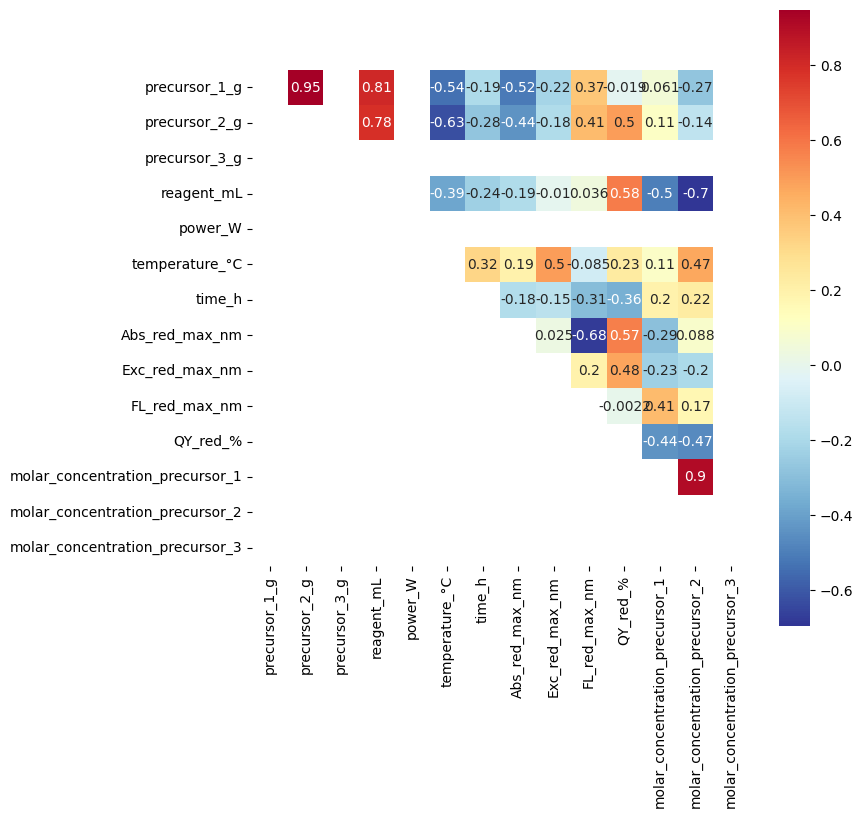

In [ ]:
corrs = new_df.corr(numeric_only=True)
upper_tri = corrs.where(np.triu(np.ones(corrs.shape), k=1).astype(bool))

#build a heatmap on the upper triangle
plt.figure(figsize=(8, 8))
sns.heatmap(upper_tri, cmap="RdYlBu_r", square=True, annot=True);

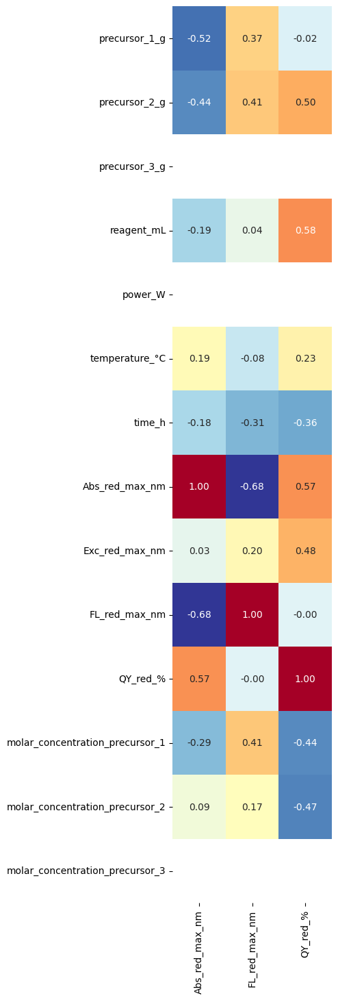

In [ ]:
targets = ['Abs_red_max_nm', 'FL_red_max_nm', 'QY_red_%']
corrs = new_df.corr(numeric_only=True)


# Filtering the correlation matrix for targets
target_corrs = corrs[targets]

# Determining the size of a figure
num_targets = len(targets)
num_features = len(new_df.columns) - num_targets
fig, ax = plt.subplots(figsize=(num_targets, num_features))

# Constructing a correlation map
heatmap = sns.heatmap(target_corrs, cmap="RdYlBu_r", annot=True, fmt=".2f", cbar=False, ax=ax)

# Customize labels and axis positions
heatmap.set_xticklabels(heatmap.get_xticklabels(), rotation=90)
heatmap.set_yticklabels(heatmap.get_yticklabels(), rotation=0)
plt.yticks(va="center")

plt.show()

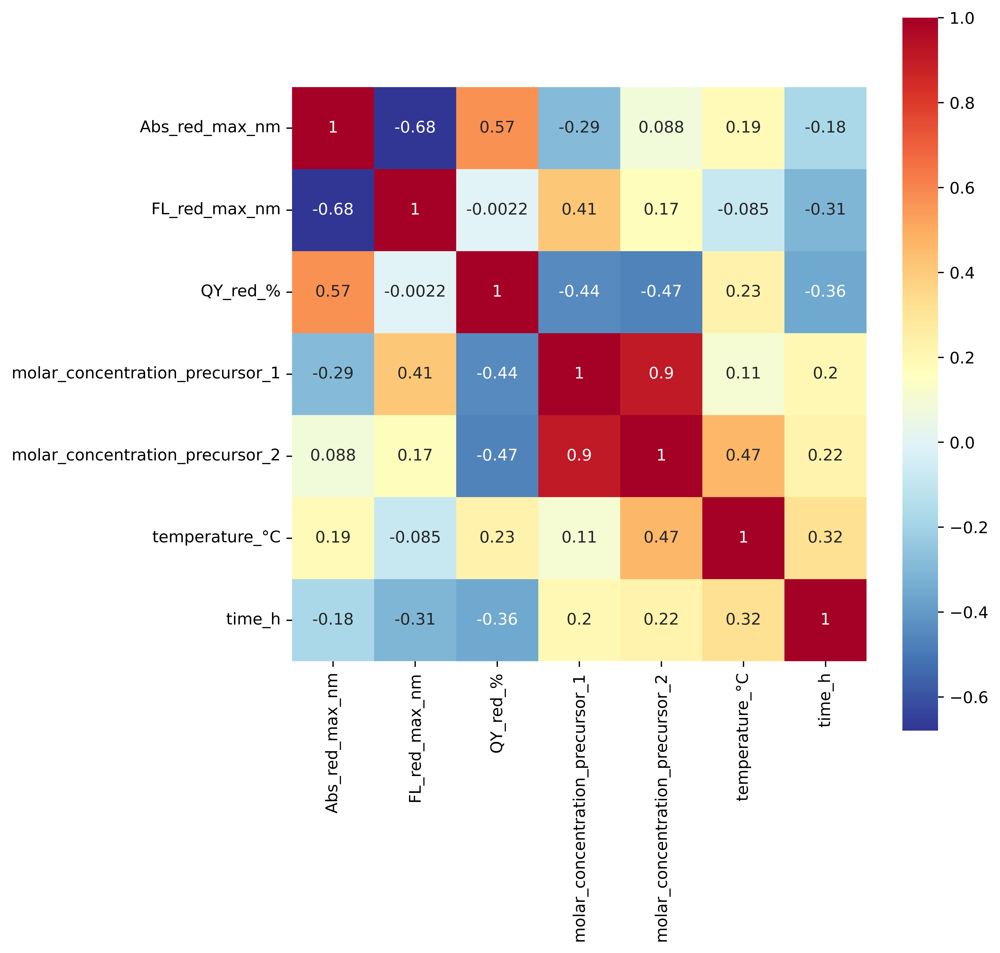

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

vertical_columns = ['Abs_red_max_nm', 'FL_red_max_nm', 'QY_red_%']  # Columns to display vertically
horizontal_columns = ['molar_concentration_precursor_1', 'molar_concentration_precursor_2',	'temperature_°C',	'time_h']  # Columns to display horizontally
corrs = new_df[vertical_columns + horizontal_columns].corr(numeric_only=True)

# Constructing a correlation map
plt.figure(figsize=(8, 8), dpi=800)
sns.heatmap(corrs, cmap="RdYlBu_r", annot=True, square=True)

plt.show()


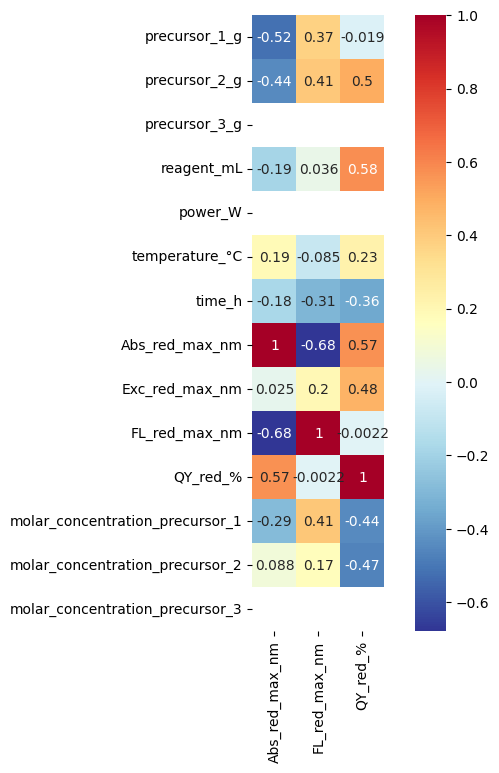

In [ ]:
targets = ['Abs_red_max_nm', 'FL_red_max_nm', 'QY_red_%']
corrs = new_df.corr(numeric_only=True)

# Removing columns that are not targets
filtered_corrs = corrs[targets]

plt.figure(figsize=(8, 8))
sns.heatmap(filtered_corrs, cmap="RdYlBu_r", annot=True, square=True)

plt.show()

<ipython-input-27-2b01a1f07589>:10: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  plt.tight_layout()


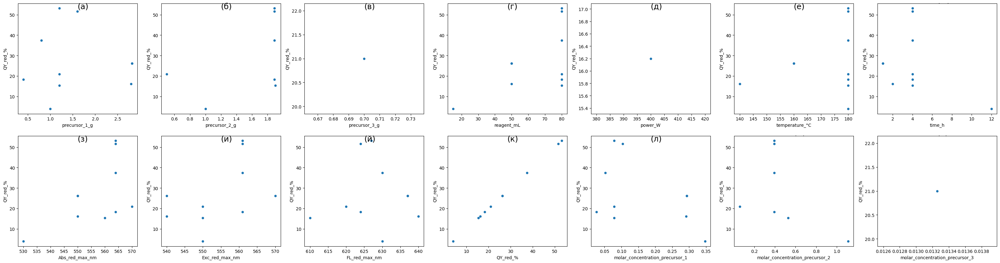

In [ ]:
train_df_numerical_2 = new_df.select_dtypes(include=['float64', 'int64'])

fig, axes = plt.subplots(nrows=2, ncols=7, figsize=(40, 10))
count = 0
for idx, feature in enumerate(train_df_numerical_2.columns):
    train_df_numerical_2.plot(feature, "QY_red_%", subplots=True, kind="scatter", ax=axes[count // 7, count % 7])
    axes[count // 7, count % 6].text(0.5, 0.95, f'({chr(1072 + count)})', transform=axes[count // 7, count % 7].transAxes, fontsize=18) #.text(0.5, 0.95, меняет положение (а)
    count += 1

plt.tight_layout()
plt.show()

In [ ]:
#sns.pairplot(new_df);

In [ ]:
#delete the lines where the quantum output QY red is zero and create a dataset only from targets
train_dfCLASTER = train_df.loc[(train_df['QY_red_%'].notnull()) & (train_df['Abs_red_max_nm'].notnull())]
X=train_dfCLASTER.loc[:, ['FL_red_max_nm', 'Abs_red_max_nm', 'QY_red_%']]

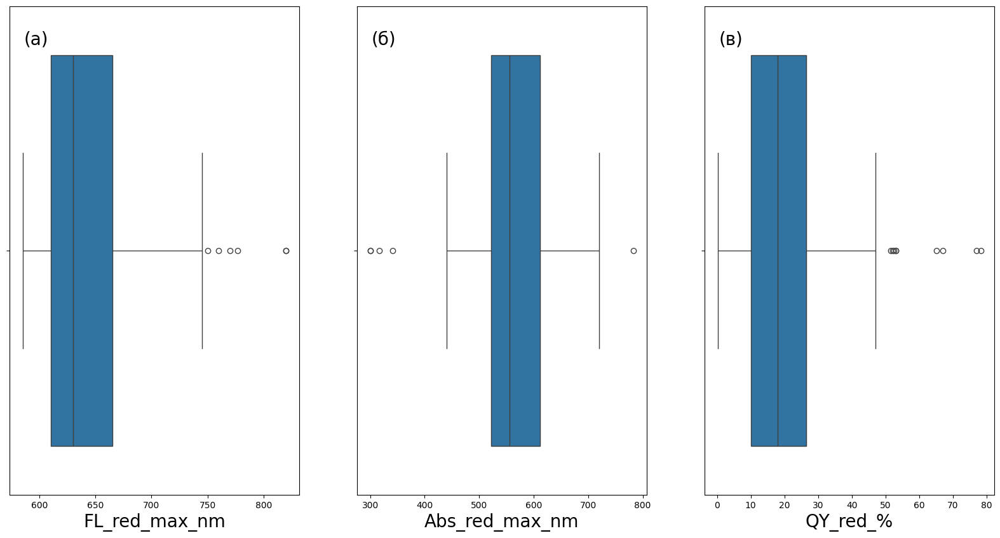

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 10))
count = 0

for idx, feature in enumerate(X.columns):
        sns.boxplot(x=X[feature], ax=axes[count])
        axes[count].text(0.05, 0.95, f"({chr(1072+idx)})", transform=axes[count].transAxes, fontsize=20, va='top')
        axes[count].set_xlabel(feature, fontsize=20)
        count += 1

plt.show()

In [ ]:
X.describe()

,FL_red_max_nm,Abs_red_max_nm,QY_red_%
count,105.000000,105.000000,105.000000
mean,644.180952,562.914286,21.586000
std,48.326967,84.083648,16.516477
min,585.000000,300.000000,0.200000
25%,610.000000,522.000000,10.140000
50%,630.000000,556.000000,17.900000
75%,665.000000,612.000000,26.460000
max,820.000000,783.000000,78.300000


In [ ]:

from matplotlib.cbook import boxplot_stats
#we get the values of data outliers which are presented in the graphs above
for col in X.columns:
    print(f'Outliers for {col} column: {boxplot_stats(X[col]).pop(0)["fliers"]}\n')

Outliers for FL_red_max_nm column: [770 820 820 777 760 750]

Outliers for Abs_red_max_nm column: [341. 317. 300. 300. 783.]

Outliers for QY_red_% column: [53.1 51.6 53.  67.  52.  65.  77.  52.4 78.3]



In [ ]:
# Obtained emission values
outliers = {
    'FL_red_max_nm': [820, 820],
    'Abs_red_max_nm': [341, 783]
}

# Filter the data, excluding outlier values
X_new = X[~X.isin(outliers).any(axis=1)]

# Print the sizes of the original and new data sets
print("Размер исходного набора данных:", X.shape)
print("Размер нового набора данных:", X_new.shape)

Размер исходного набора данных: (105, 3)
Размер нового набора данных: (102, 3)


In [ ]:
X_new


,FL_red_max_nm,Abs_red_max_nm,QY_red_%
1,770,720.0,11.00
2,720,650.0,0.20
3,710,631.0,26.28
4,650,570.0,20.00
8,630,530.0,4.00
...,...,...,...
121,605,567.0,17.90
122,605,567.0,7.50
123,610,540.0,19.70
124,610,490.0,18.20


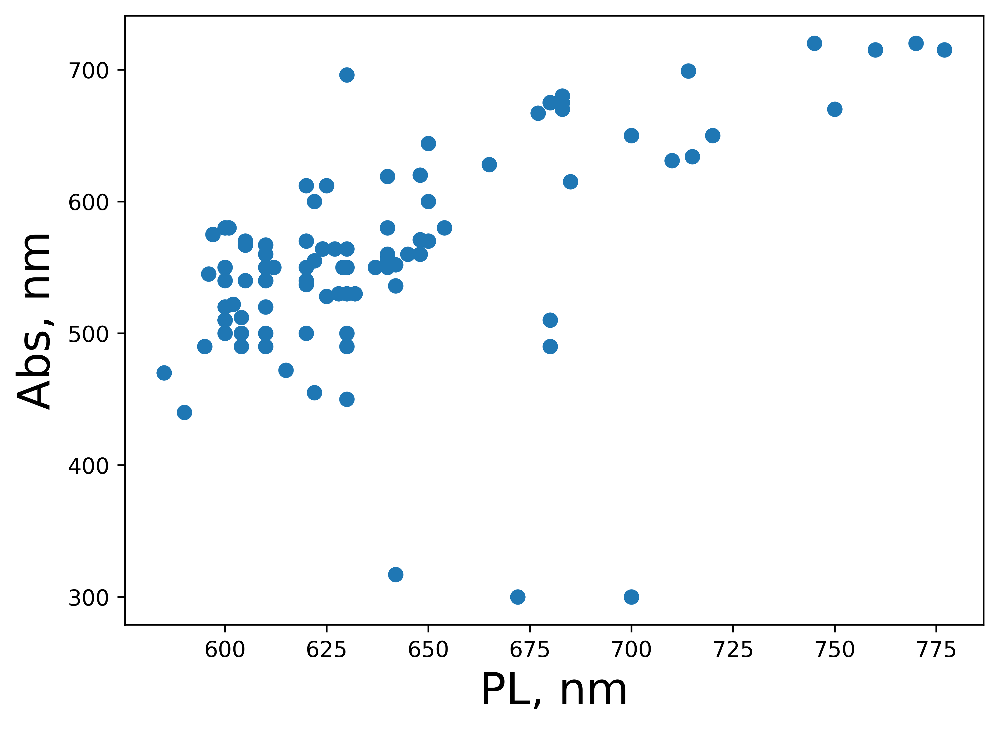

In [ ]:
#Below we will construct distributions in 2-dimensional space of pairwise optical properties


x_axis=X_new['FL_red_max_nm']
y_axis=X_new['Abs_red_max_nm']
plt.figure(figsize=(7, 5), dpi=600)
plt.xlabel('PL, nm', fontsize=20)
plt.ylabel('Abs, nm', fontsize=20)
plt.scatter(x_axis, y_axis)
plt.show()

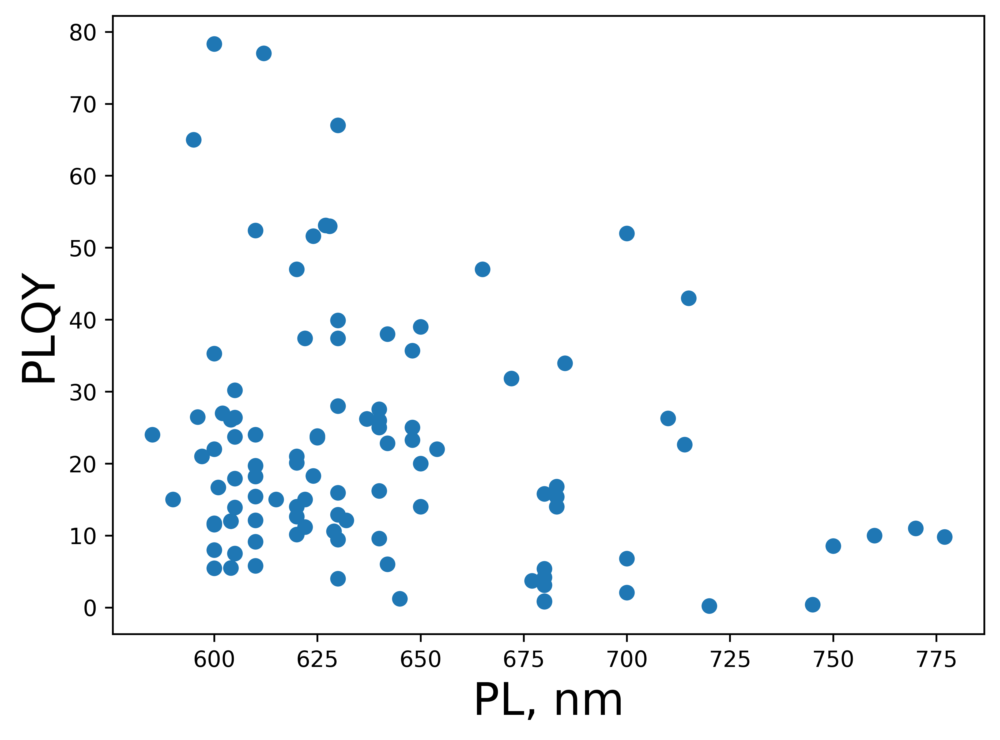

In [ ]:
x_axis=X_new['FL_red_max_nm']
y_axis=X_new['QY_red_%']
plt.figure(figsize=(7, 5), dpi=600)
plt.xlabel('PL, nm', fontsize=20)
plt.ylabel('PLQY', fontsize=20)
plt.scatter(x_axis, y_axis)
plt.show()

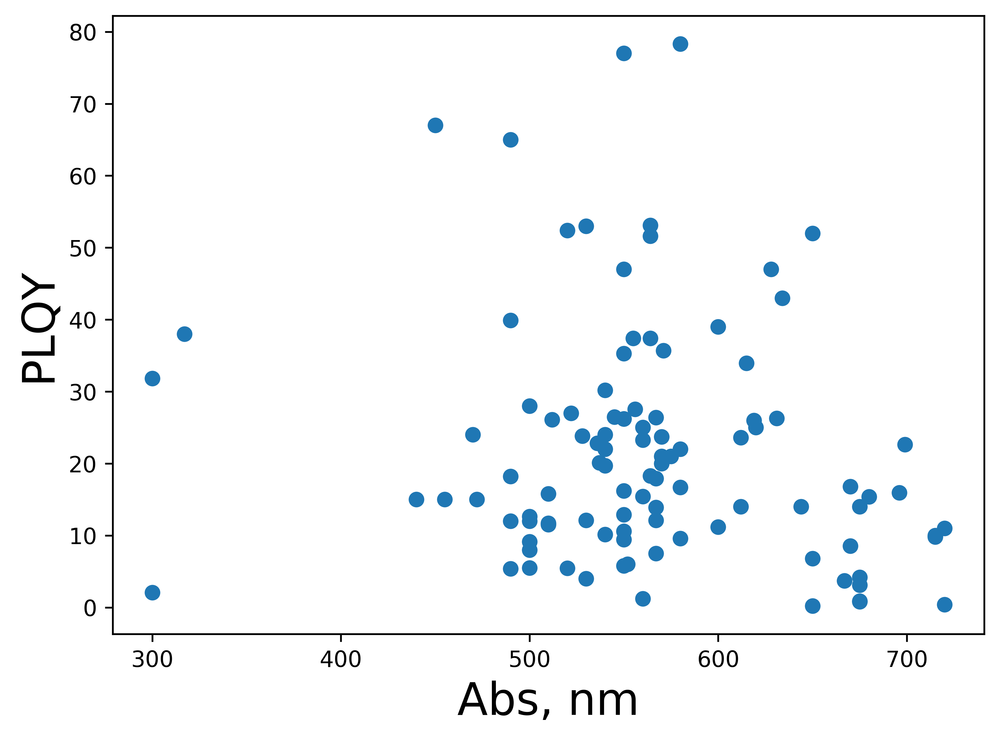

In [ ]:
x_axis=X_new['Abs_red_max_nm']
y_axis=X_new['QY_red_%']
plt.figure(figsize=(7, 5), dpi=600)
plt.xlabel('Abs, nm', fontsize=20)
plt.ylabel('PLQY', fontsize=20)
plt.scatter(x_axis, y_axis)
plt.show()

Let's consider the work of clustering without reducing the dimension of space (without TSNE and PCA)

In [ ]:
fig, ax = plt.subplots(figsize=(15, 15),dpi=1000, subplot_kw={'projection': '3d'})

ax.scatter(X_new['QY_red_%'], X_new['Abs_red_max_nm'], X_new['FL_red_max_nm'], s=40)

##for x, y, z in zip(X['QY_red_%'], X['Abs_red_max_nm'], X['FL_red_max_nm']):
 #   ax.plot([x, x], [y, y], [z, 0], linestyle='--', color='gray')
   # ax.plot([x, x], [y, 0], [z, z], linestyle='--', color='gray')
   # ax.plot([x, 0], [y, y], [z, z], linestyle='--', color='gray')

ax.set_xlabel('PLQY',fontsize=15)
ax.set_ylabel('Abs', fontsize=15)
ax.set_zlabel('PL', fontsize=15)

for i, row in X_new.iterrows():
    ax.text(row['QY_red_%'], row['Abs_red_max_nm'], row['FL_red_max_nm'], s=i, fontsize=8)


plt.show()

<ipython-input-39-a6c331d858cb>:14: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(scalarMap)


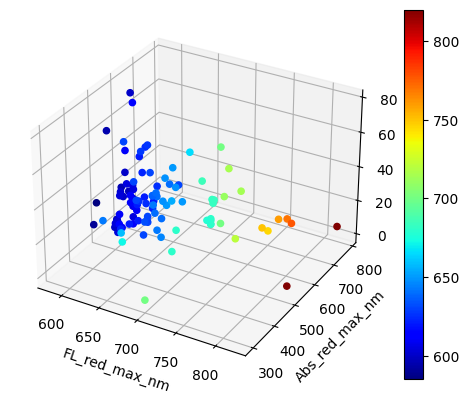

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import pandas as pd
from mpl_toolkits.mplot3d import proj3d

def scatterplot3d(x,y,z, cs, colorsMap='jet'):
    cm = plt.get_cmap(colorsMap)
    cNorm = plt.Normalize(min(cs), max(cs))
    scalarMap = plt.cm.ScalarMappable(norm=cNorm, cmap=cm)
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(x, y, z, c=scalarMap.to_rgba(cs), alpha=1)
    scalarMap.set_array(cs)
    plt.colorbar(scalarMap)
    return ax

ax = scatterplot3d(X['FL_red_max_nm'], X['Abs_red_max_nm'], X['QY_red_%'], X['FL_red_max_nm'], colorsMap='jet')
ax.set_xlabel('FL_red_max_nm')
ax.set_ylabel('Abs_red_max_nm')
ax.set_zlabel('QY_red_%')

plt.show()


Before use, normalization is necessary (since this method calculates distances - this is how the proximity of points is determined). At different scales, each feature contributes its share, and for large features the share will be significant - you don’t want to conclude just from a large feature that the point is close to the one being studied

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


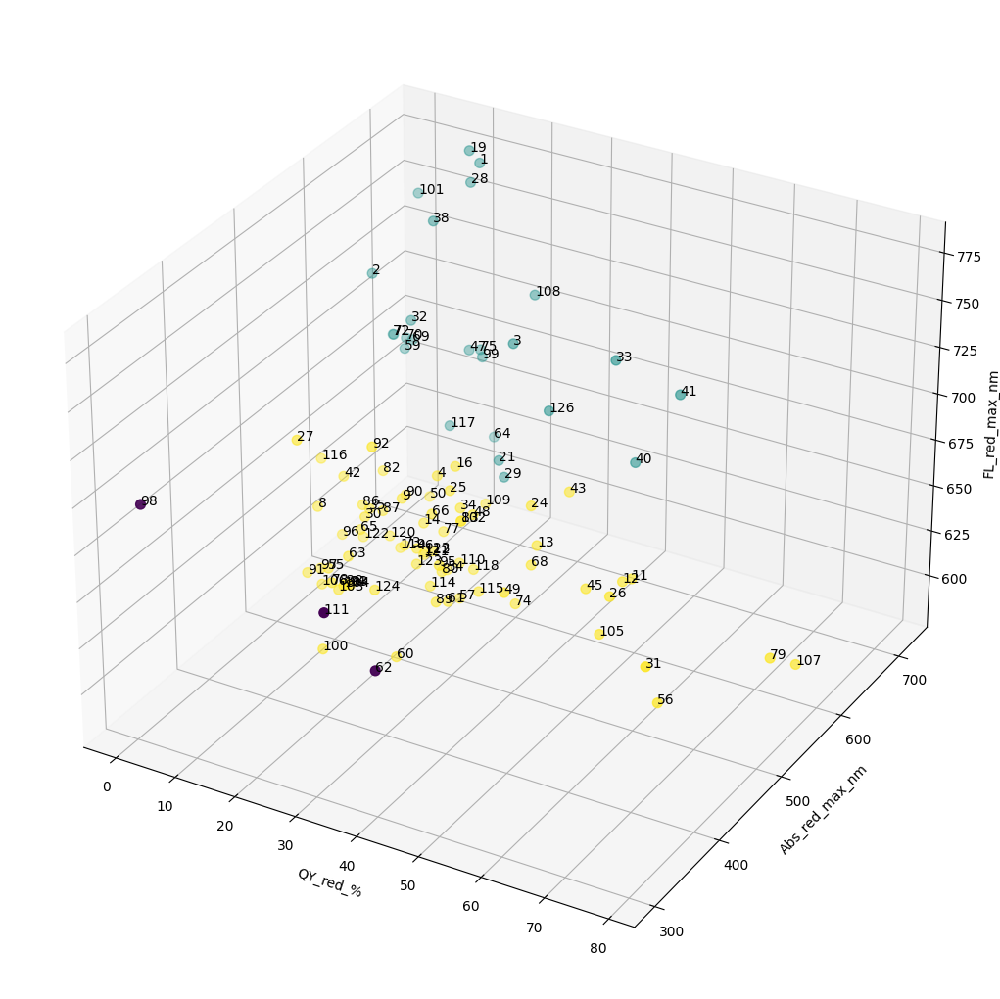

In [ ]:
#Before normalization
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler

# cluster data using KMeans
kmeans = KMeans(n_clusters=3, random_state=0)
labels = kmeans.fit_predict(X_new)

fig, ax = plt.subplots(figsize=(13, 13), subplot_kw={'projection': '3d'})

ax.scatter(X_new['QY_red_%'], X_new['Abs_red_max_nm'], X_new['FL_red_max_nm'], c=labels, cmap='viridis', s=50)

##for x, y, z in zip(X['QY_red_%'], X['Abs_red_max_nm'], X['FL_red_max_nm']):
 #   ax.plot([x, x], [y, y], [z, 0], linestyle='--', color='gray')
   # ax.plot([x, x], [y, 0], [z, z], linestyle='--', color='gray')
   # ax.plot([x, 0], [y, y], [z, z], linestyle='--', color='gray')

ax.set_xlabel('QY_red_%')
ax.set_ylabel('Abs_red_max_nm')
ax.set_zlabel('FL_red_max_nm')

for i, row in X_new.iterrows():
    ax.text(row['QY_red_%'], row['Abs_red_max_nm'], row['FL_red_max_nm'], s=i, fontsize=10)

plt.show()

In [ ]:
indexes = X_new.index

# After normalization
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler

#Let's do normalization
mms = MinMaxScaler()
X_new_norm = mms.fit_transform(X_new)
X_new_norm = pd.DataFrame(X_new_norm, columns=X_new.columns)

# Clustering data using KMeans
kmeans = KMeans(n_clusters=4, random_state=0)
labels = kmeans.fit_predict(X_new_norm)

fig, ax = plt.subplots(figsize=(13, 13), dpi=1000, subplot_kw={'projection': '3d'})

scatter = ax.scatter(X_new_norm['QY_red_%'], X_new_norm['Abs_red_max_nm'], X_new_norm['FL_red_max_nm'], c=labels, s=50)

# for x, y, z in zip(X['QY_red_%'], X['Abs_red_max_nm'], X['FL_red_max_nm']):
#     ax.plot([x, x], [y, y], [z, 0], linestyle='--', color='gray')
#     ax.plot([x, x], [y, 0], [z, z], linestyle='--', color='gray')
#     ax.plot([x, 0], [y, y], [z, z], linestyle='--', color='gray')

ax.set_xlabel('PLQY',fontsize=15)
ax.set_ylabel('Abs', fontsize=15)
ax.set_zlabel('PL', fontsize=15)

for i, row in X_new_norm.iterrows():
    ax.text(row['QY_red_%'], row['Abs_red_max_nm'], row['FL_red_max_nm'], s=indexes[i], fontsize=8)

# Create a legend
legend_elements = []
for cluster_label in set(labels):
    legend_elements.append(plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=scatter.to_rgba(cluster_label), markersize=12, label=f'Cluster {cluster_label}'))


ax.legend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, -0.001), ncol=len(legend_elements))

plt.figure(dpi=1000)
plt.show()


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


<Figure size 6400x4800 with 0 Axes>

In [ ]:
# Obtained data outlier values
outliers = {
    'FL_red_max_nm': [820, 820],
    'Abs_red_max_nm': [341, 783]
}
#train_dfCLASTER2 was created to make labels

# We filter the data, excluding outlier values
train_dfCLASTER2 = train_dfCLASTER[~train_dfCLASTER.isin(outliers).any(axis=1)]

# Create four tables based on cluster labels
table_0 = train_dfCLASTER2[labels == 0]
table_1 = train_dfCLASTER2[labels == 1]
table_2 = train_dfCLASTER2[labels == 2]
table_3 = train_dfCLASTER2[labels == 3]
table_4 = train_dfCLASTER2[labels == 4]
table_5 = train_dfCLASTER2[labels == 5]

In [ ]:
# Cluster prediction for new strings (for example, we carry out synthesis in the laboratory)
new_data = pd.DataFrame({'FL_red_max_nm': [645], 'Abs_red_max_nm': [595],'QY_red_%': [15]})
new_data_norm = mms.transform(new_data)  # Normalization of new data
predicted_labels = kmeans.predict(new_data_norm)  # Predicting cluster labels

# Output predicted cluster labels
print(f"Predicted cluster labels for new data: {predicted_labels}")

Predicted cluster labels for new data: [3]


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[7.838912005711492, 5.319336052526235, 4.213444953345125, 3.5932616526651273, 2.998001494283172, 2.4258102307994713, 2.09066113513464, 1.805143870660027]


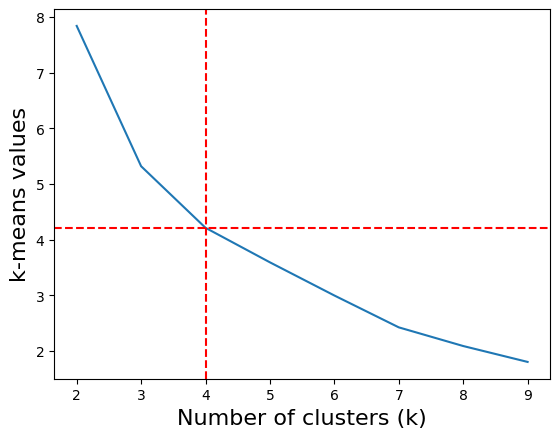

In [ ]:
#Calculate the value of the k-means criterion for different k and store all these values in the list of criteria:
criteries = []

for k in range(2,10):
#Create a model for clusterers with a number equal to the current value of k, train it, and add
#calculated criterion to our list of criteria:
  kmeansModel=KMeans(n_clusters=k, random_state=7)
  kmeansModel.fit(X_new_norm)
  criteries.append(kmeansModel.inertia_)
print(criteries)
#For the elbow method, we have to plot the resulting values. On the X axis we will have
#k values, along the y axis - calculated criterion values:
plt.plot(range(2,10), criteries)
plt.xlabel('Number of clusters (k)',fontsize=16)
plt.ylabel('k-means values',fontsize=16)
#On the graph we identify a value of k at which the value of the k-means criterion will decrease
#not too fast (4).
#The resulting number 4 is the recommended value for the number of clusters

# Add perpendicular red dotted lines for k=4
k_value = 4
plt.axvline(x=k_value, color='red', linestyle='--')
plt.axhline(y=criteries[k_value-2], color='red', linestyle='--')

plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

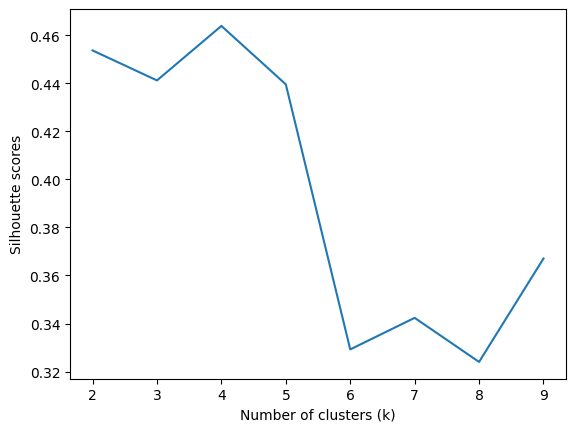

In [ ]:
from sklearn.metrics import silhouette_score

silhouette_scores = []

for k in range(2, 10):
    kmeans_model = KMeans(n_clusters=k, random_state=7)

    kmeans_model.fit(X_new_norm)

    labels = kmeans_model.labels_

    silhouette_avg = silhouette_score(X_new_norm, labels)

    silhouette_scores.append(silhouette_avg)

plt.plot(range(2, 10), silhouette_scores)
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette scores')
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

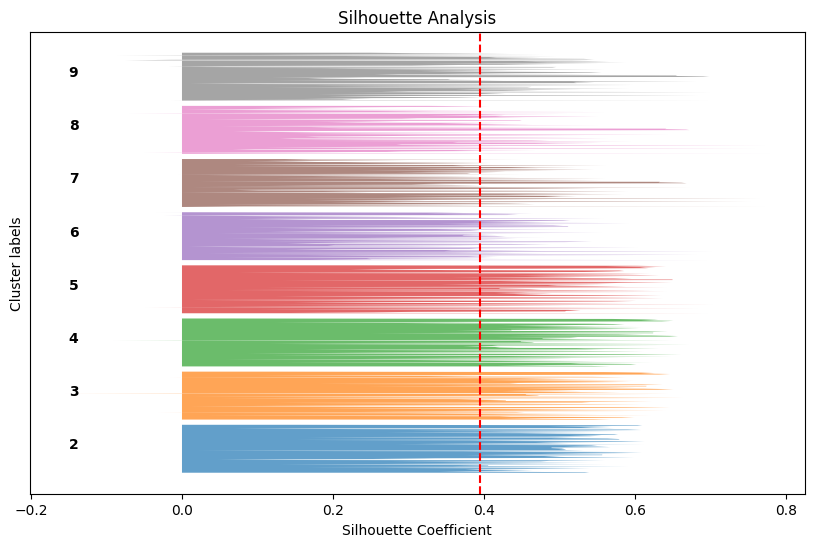

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score


k_values = range(2, 10)

silhouette_scores = []

silhouette_values = {}

for k in k_values:
    kmeans_model = KMeans(n_clusters=k, random_state=7)
    cluster_labels = kmeans_model.fit_predict(X_new_norm)
    silhouette_avg = silhouette_score(X_new_norm, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    silhouette_values[k] = silhouette_samples(X_new_norm, cluster_labels)


plt.figure(figsize=(10, 6))

for i, k in enumerate(k_values):
    y_start = i * len(X_new_norm) + (i + 1) * 10
    y_end = y_start + len(X_new_norm)
    values = silhouette_values[k]
    plt.fill_betweenx(np.arange(y_start, y_end), 0, values, alpha=0.7)
    plt.text(-0.15, (y_start + y_end) / 2, str(k), color='black', fontweight='bold')

plt.yticks([])
plt.xticks(np.arange(-0.2, 1, 0.2))
plt.xlabel('Silhouette Coefficient')
plt.ylabel('Cluster labels')
plt.title('Silhouette Analysis')

plt.axvline(x=np.mean(silhouette_scores), color='red', linestyle='--')

plt.show()


In [ ]:
table_0

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
62,10.1002/advs.202300543,ST,m-hydroxybenzaldehyde,NaN,NaN,ethanol,2.000,NaN,NaN,10.0,NaN,180.0,8.0,317.0,570.0,642,38.00,1.041667,NaN,NaN
98,10.1016/j.carbon.2018.10.047,ST,Poly(3-alkylthiophene),NaN,NaN,NaOH/water,0.030,NaN,NaN,40.0,NaN,170.0,20.0,300.0,NaN,700,2.06,0.008621,NaN,NaN
111,10.1039/C9NH00287A,ST,1_3_5-benzenetrithiol,NaN,NaN,H2SO4/ethanol,0.174,NaN,NaN,10.0,NaN,200.0,2.0,300.0,626.0,672,31.82,0.100000,NaN,NaN


In [ ]:
table_1

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
11,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.200,1.890,NaN,80.0,NaN,180.0,4.0,564.0,561.0,627,53.1,0.078125,0.393750,NaN
12,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.600,1.890,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,51.6,0.104167,0.393750,NaN
13,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.800,1.890,NaN,80.0,NaN,180.0,4.0,564.0,561.0,630,37.4,0.052083,0.393750,NaN
24,10.1007/s12274-019-2293-z,ST,L-cystine,o-phenylenediamine,NaN,ethanol,0.125,0.500,NaN,20.0,NaN,220.0,12.0,571.0,540.0,648,35.7,0.051653,0.231481,NaN
26,10.1002/adma.201702910,ST,1_3-Dihydroxynaphthalene,KIO4,NaN,ethanol,0.010,0.040,NaN,10.0,NaN,180.0,1.0,530.0,540.0,628,53.0,0.006250,0.017391,NaN
31,10.1021/acsami.8b03529,HT,CA,5-amino-1_10- phenanthroline,NaN,water,1.350,0.150,NaN,15.0,NaN,200.0,7.0,450.0,560.0,630,67.0,0.468750,0.051282,NaN
40,10.1126/sciadv.abb6772,ST,terephthalic acid,o-phenylenediamine,NaN,ethanol,0.100,0.100,NaN,10.0,NaN,180.0,12.0,628.0,600.0,665,47.0,0.060241,0.092593,NaN
41,10.1126/sciadv.abb6773,ST,terephthalic acid,o-phenylenediamine,NaN,ethanol,0.200,0.100,NaN,10.0,NaN,180.0,12.0,650.0,640.0,700,52.0,0.120482,0.092593,NaN
43,10.1016/j.jallcom.2017.01.124,ST,CA,urea,NaN,DMF,1.000,2.000,NaN,10.0,NaN,200.0,6.0,600.0,550.0,650,39.0,0.520833,3.333333,NaN
45,10.1088/1361-6528/aaa321,ST,CA,urea,NaN,DMF,1.000,2.000,NaN,10.0,NaN,180.0,8.0,550.0,540.0,620,47.0,0.520833,3.333333,NaN


In [ ]:
table_2

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,10.1002/smll.201905050,ST,CA,urea,NaN,DMF,2.000,4.000,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
2,10.1038/s41377-018-0090-1,ST,CA,urea,NaN,DMSO,2.000,6.000,NaN,30.0,NaN,160.0,4.0,650.0,655.0,720,0.20,0.347222,3.333333,NaN
3,10.1002/adma.201603443,HT,Dopamine,o-phenylenediamine,NaN,water,0.184,0.108,NaN,10.0,NaN,200.0,8.0,631.0,540.0,710,26.28,0.120261,0.180000,NaN
19,10.1002/smll.202000680,ST,CA,urea,NH4F,DMF,2.000,4.000,0.195,20.0,NaN,180.0,4.0,715.0,710.0,777,9.80,0.520833,3.333333,0.263514
28,10.1002/adma.201705913,ST,CA,urea,NaN,DMF,2.000,4.000,NaN,20.0,NaN,160.0,6.0,715.0,732.0,760,10.00,0.520833,3.333333,NaN
32,10.1038/s41551-020-0540-y,HT,CA,1_4_5_8-tetraminoanthraquinone,NaN,water,0.040,0.030,NaN,10.0,NaN,180.0,2.0,650.0,600.0,700,6.80,0.020833,0.011194,NaN
33,10.1002/smll.201800612,ST,l-glutamic acid,o-phenylenediamine,NaN,H2SO4/water,0.110,0.160,NaN,25.0,NaN,210.0,10.0,634.0,600.0,715,43.00,0.029932,0.059259,NaN
38,10.1021/acsabm.8b00029,HT,CA,Tetraamino porphyrin,NaN,water,1.000,0.100,NaN,20.0,NaN,200.0,3.0,670.0,440.0,750,8.54,0.260417,0.007407,NaN
47,10.1002/adfm.202213856,ST,Glutathione,Folic acid,NaN,formamide,2.100,0.105,NaN,70.0,NaN,140.0,6.0,675.0,675.0,683,14.00,0.097720,0.003401,NaN
59,10.1016/j.jlumin.2023.119727,ST,spirulina powder,NaN,NaN,water/ethanol,0.600,NaN,NaN,30.0,NaN,150.0,6.0,667.0,420.0,677,3.72,0.083333,NaN,NaN


In [ ]:
table_3

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
4,10.1021/acsabm.1c00121,HT,o-phenylenediamine,urea,NaN,H2SO4/water,0.2,0.13,NaN,30.0,NaN,210.0,8.0,570.0,580.0,650,20.0,0.061728,0.072222,NaN
8,10.1021/acsnano.7b06399,ST,CA,urea,NaN,formamide,1.0,1.00,NaN,15.0,NaN,180.0,12.0,530.0,550.0,630,4.0,0.347222,1.111111,NaN
9,10.1021/acs.chemmater.6b03695,MW,CA,NaN,NaN,formamide,2.8,NaN,NaN,50.0,400.0,140.0,2.0,550.0,540.0,640,16.2,0.291667,NaN,NaN
14,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.4,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,18.3,0.026042,0.393750,NaN
16,10.1515/nanoph-2020-0233,ST,CA,urea,NaN,DMF,1.0,2.00,NaN,10.0,NaN,160.0,4.0,580.0,594.0,654,22.0,0.520833,3.333333,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120,10.3390/ma14164716,ST,1_4-diaminonaphthalene,NaN,NaN,ethanol,0.1,NaN,NaN,10.0,NaN,180.0,10.0,567.0,NaN,610,12.1,0.063291,NaN,NaN
121,10.3390/ma14164716,ST,1_4-diaminonaphthalene,NaN,NaN,acetone,0.1,NaN,NaN,10.0,NaN,180.0,10.0,567.0,NaN,605,17.9,0.063291,NaN,NaN
122,10.3390/ma14164716,ST,1_4-diaminonaphthalene,NaN,NaN,DMF,0.1,NaN,NaN,10.0,NaN,180.0,10.0,567.0,NaN,605,7.5,0.063291,NaN,NaN
123,10.1007/s00604-022-05543-8,ST,3_4-diaminobenzoic acid,NaN,NaN,HCl/water,0.1,NaN,NaN,10.0,NaN,200.0,10.0,540.0,NaN,610,19.7,0.065789,NaN,NaN


In [ ]:
table_0.to_csv('table_0.csv', index=False)
table_1.to_csv('table_1.csv', index=False)
table_2.to_csv('table_2.csv', index=False)
table_3.to_csv('table_3.csv', index=False)

from google.colab import files

files.download('table_0.csv')
files.download('table_1.csv')
files.download('table_2.csv')
files.download('table_3.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

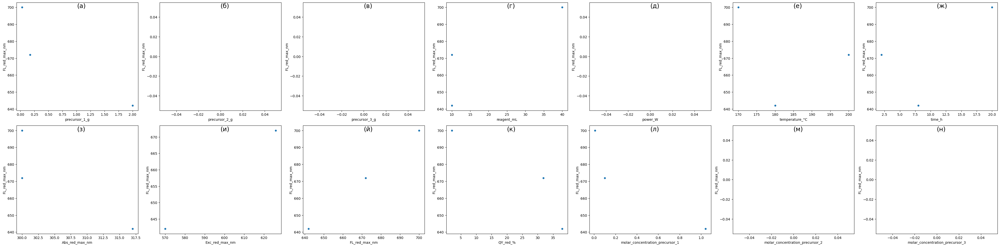

In [ ]:
#LET'S LOOK AT THE DEPENDENCIES WITHIN EACH CLUSTER
dataset_1 = table_0.select_dtypes(include=['float64', 'int64'])

fig, axes = plt.subplots(nrows=2, ncols=7, figsize=(40, 10))
count = 0
for idx, feature in enumerate(dataset_1.columns):
    dataset_1.plot(feature, "FL_red_max_nm", subplots=True, kind="scatter", ax=axes[count // 7, count % 7])
    axes[count // 7, count % 7].text(0.5, 0.95, f'({chr(1072 + count)})', transform=axes[count // 7, count % 7].transAxes, fontsize=18) #.text(0.5, 0.95, changes position(a)
    count += 1

plt.tight_layout()
plt.show()

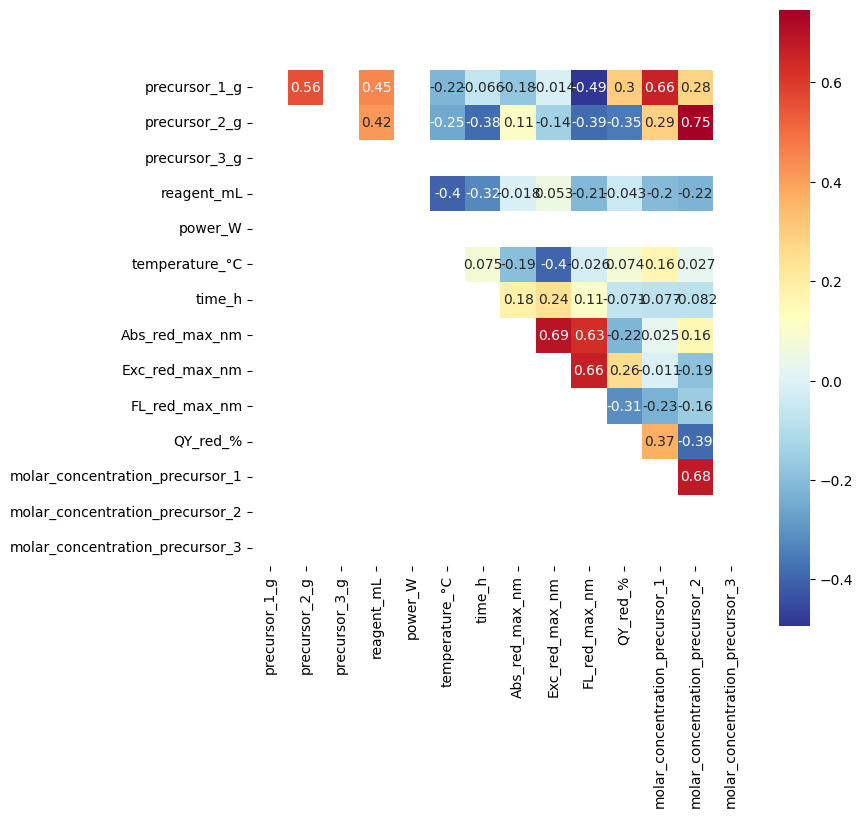

In [ ]:
dataset_1 = table_1.select_dtypes(include=['float64', 'int64'])

corrs = dataset_1.corr()
upper_tri = corrs.where(np.triu(np.ones(corrs.shape), k=1).astype(bool))

plt.figure(figsize=(8, 8))
sns.heatmap(upper_tri, cmap="RdYlBu_r", square=True, annot=True);

In [ ]:
vertical_columns = ['Abs_red_max_nm', 'FL_red_max_nm', 'QY_red_%']  # Столбцы для отображения по вертикали
horizontal_columns = ['molar_concentration_precursor_1', 'molar_concentration_precursor_2',	'temperature_°C',	'time_h' ]  # Столбцы для отображения по горизонтали
corrs_1 = dataset_1[vertical_columns + horizontal_columns].corr(numeric_only=True)

plt.figure(figsize=(8, 8), dpi=1000)
sns.heatmap(corrs_1, cmap="RdYlBu_r", annot=True, square=True)

plt.show()

Linear models


In [ ]:
#equations for clusters
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.metrics import mean_squared_error
table_1_QY= table_1.loc[(table_1['Abs_red_max_nm'].notnull()) & (table_1['molar_concentration_precursor_2'].notnull()) & (table_1['temperature_°C'].notnull()) & (table_1['time_h'].notnull())]

x_cluster= table_1_QY[['molar_concentration_precursor_1','molar_concentration_precursor_2','temperature_°C','time_h']]
y_cluster = table_1_QY['FL_red_max_nm']

regr_cluster = linear_model.LinearRegression()
regr_cluster.fit(x_cluster, y_cluster)

pred_cluster=regr_cluster.predict(x_cluster)

mse_cluster = mean_squared_error(y_cluster, pred_cluster)
mae_cluster=abs(pred_cluster-y_cluster).mean()
rmse_cluster = mean_squared_error(table_1_QY['FL_red_max_nm'], pred_cluster,squared=False)
r_sq_cluster = regr_cluster.score(x_cluster, y_cluster)

print(f'coefficient of determination:{r_sq_cluster:.2f}')
print(f'MSE {mse_cluster:.1f}')
print(f'RMSE {rmse_cluster:.1f}')
print(f'MAE {mae_cluster:.1f}')

coefficient of determination:0.16
MSE 532.6
RMSE 23.1
MAE 15.7


In [ ]:
# Obtaining coefficients and intercept for linear regression
coefficients_cluster = regr_cluster.coef_
intercept_cluster = regr_cluster.intercept_

# Print regression equation
equation_cluster = 'y = '
for i, coef in enumerate(coefficients_cluster):
    equation_cluster += f'({coef:.2f} * x{i+1}) + '
equation_cluster += f'{intercept_cluster:.2f}'
print(equation_cluster)

y = (-31.57 * x1) + (2.81 * x2) + (0.06 * x3) + (2.57 * x4) + 610.66


In [ ]:
#doing optimization for clusters
from scipy.optimize import minimize

# Function for optimization
def negative_prediction(x):
    return -regr_cluster.predict([x])[0]

# Getting the minimum and maximum values of features
min_values = x_cluster.min()
max_values = x_cluster.max()

# Restrictions on feature values
bounds = [(min_val, max_val) for min_val, max_val in zip(min_values, max_values)]

# Initial values for optimization (you can take average values)
initial_values = [(b[0] + b[1]) / 2 for b in bounds]

# Perform optimization
result = minimize(negative_prediction, initial_values, bounds=bounds)

# Optimal feature values
optimal_values = result.x
optimal_prediction = -result.fun

print("Optimal Feature Values:", optimal_values)
print("Optimal Prediction:", optimal_prediction)


Optimal Feature Values: [6.25000000e-03 3.33333333e+00 2.20000000e+02 1.20000000e+01]
Optimal Prediction: 663.5691524516287


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature n

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import MinMaxScaler

#table_1_QY= table_1.loc[(table_3['Abs_red_max_nm'].notnull()) & (table_3['molar_concentration_precursor_2'].notnull()) & (table_3['temperature_°C'].notnull()) & (table_3['time_h'].notnull())]

#x_cluster= table_1_QY[['molar_concentration_precursor_1','molar_concentration_precursor_2','temperature_°C','time_h']]
#y_cluster = table_1_QY[['FL_red_max_nm']]

#Let's normalize
#mms = MinMaxScaler()

#x_cluster_norm=mms.fit_transform(x_cluster)
#y_cluster_norm=mms.fit_transform(y_cluster.values.reshape(-1, 1))

In [ ]:
mse_val = [] #to store rmse values for different k
for K in range(12):
    K = K+1
    model = KNeighborsRegressor(n_neighbors = K)

    model.fit(x_cluster, y_cluster)  #fit the model
    pred=model.predict(x_cluster) #make prediction on test set
    error = mean_squared_error(y_cluster,pred) #calculate rmse
    mse_val.append(error) #store rmse values
    print('MSE value for k=' , K , 'is:', error)

MSE value for k= 1 is: 0.0
MSE value for k= 2 is: 296.7916666666667
MSE value for k= 3 is: 513.2407407407408
MSE value for k= 4 is: 530.6927083333334
MSE value for k= 5 is: 552.0933333333336
MSE value for k= 6 is: 620.0347222222223
MSE value for k= 7 is: 651.5816326530611
MSE value for k= 8 is: 655.4817708333334
MSE value for k= 9 is: 669.7746913580246
MSE value for k= 10 is: 675.0858333333332
MSE value for k= 11 is: 638.4517906336088
MSE value for k= 12 is: 632.6875


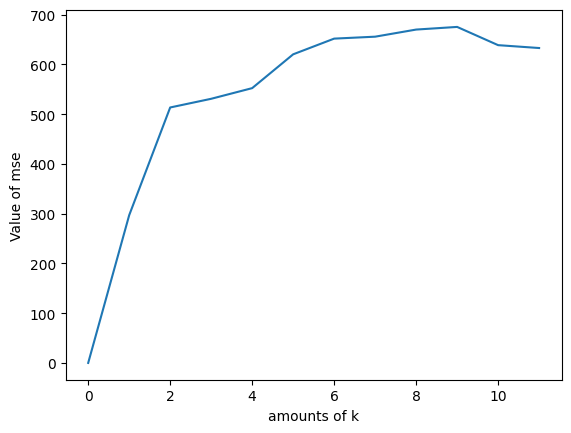

In [ ]:
plt.plot(mse_val)
plt.xlabel('amounts of k')
plt.ylabel('Value of mse')
plt.show()

In [ ]:
model = KNeighborsRegressor(n_neighbors = 1)
model.fit(x_cluster, y_cluster)

pred_cluster_knn=model.predict(x_cluster)

mse_cluster_knn = mean_squared_error(y_cluster, pred_cluster_knn)
mae_cluster_knn=abs(pred_cluster_knn-y_cluster).mean()
rmse_cluster_knn = mean_squared_error(table_1_QY['FL_red_max_nm'], pred_cluster_knn,squared=False)
r_sq_cluster_knn = model.score(x_cluster, y_cluster)

print(f'coefficient of determination:{r_sq_cluster_knn:.2f}')
print(f'MSE {mse_cluster_knn:.1f}')
print(f'RMSE {rmse_cluster_knn:.1f}')
print(f'MAE {mae_cluster_knn}')

coefficient of determination:1.00
MSE 0.0
RMSE 0.0
MAE 0.0


In [ ]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import plot_tree

regr = DecisionTreeRegressor(random_state=0)
regr.fit(x_cluster, y_cluster)

DecisionTreeRegressor(random_state=0)

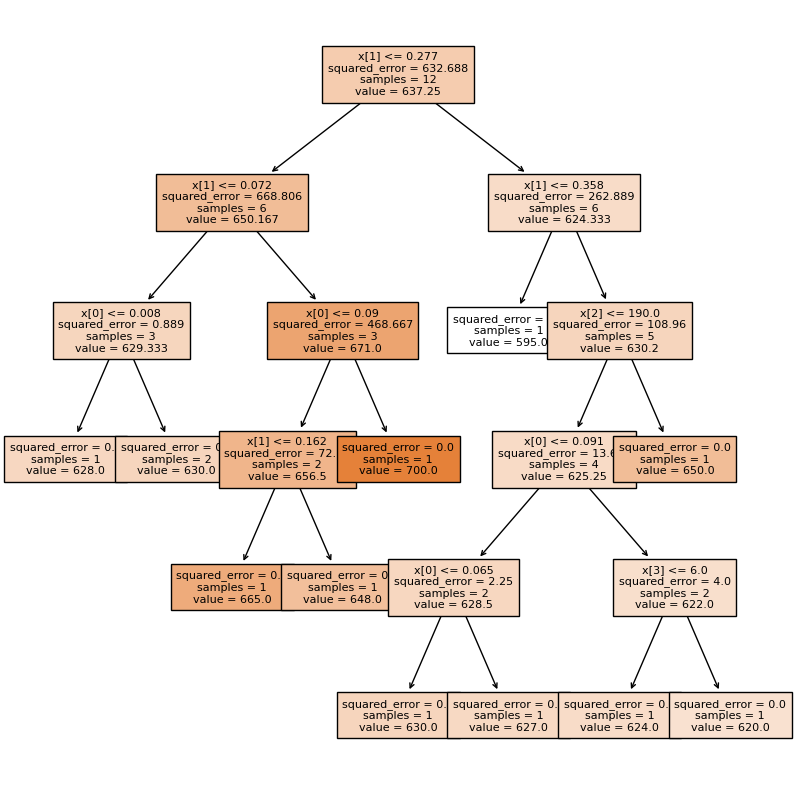

In [ ]:
plt.figure(figsize=(10,10))
plot_tree(regr, filled=True, fontsize=8)
plt.show()

In [ ]:
r_sq_cluster_DTR = regr.score(x_cluster, y_cluster)
print(f'coefficient of determination:{r_sq_cluster_DTR:.2f}')

coefficient of determination:1.00


In [ ]:
pred_cluster_DTR=regr.predict(x_cluster)

mse_cluster_DTR = mean_squared_error(y_cluster, pred_cluster_DTR)
#mae_cluster_DTR=abs(pred_cluster_DTR-y_cluster).mean()
rmse_cluster_DTR = mean_squared_error(table_1_QY['FL_red_max_nm'], pred_cluster_DTR,squared=False)
r_sq_cluster_DTR = regr.score(x_cluster, y_cluster)

print(f'coefficient of determination:{r_sq_cluster_DTR:.2f}')
print(f'MSE {mse_cluster_DTR:.1f}')
print(f'RMSE {rmse_cluster_DTR:.1f}')
#print(f'MAE {mae_cluster_knn}')

coefficient of determination:1.00
MSE 0.0
RMSE 0.0


In [ ]:
from sklearn.ensemble import RandomForestRegressor

regr_RF = DecisionTreeRegressor(random_state=0)
regr_RF.fit(x_cluster, y_cluster)

DecisionTreeRegressor(random_state=0)

In [ ]:
pred_cluster_RF=regr_RF.predict(x_cluster)

mse_cluster_RF = mean_squared_error(y_cluster, pred_cluster_RF)
#mae_cluster_RF=abs(pred_cluster_RF-y_cluster).mean()
rmse_cluster_RF = mean_squared_error(table_1_QY['FL_red_max_nm'], pred_cluster_RF,squared=False)
r_sq_cluster_RF = regr_RF.score(x_cluster, y_cluster)

print(f'coefficient of determination:{r_sq_cluster_RF:.2f}')
print(f'MSE {mse_cluster_RF:.1f}')
print(f'RMSE {rmse_cluster_RF:.1f}')
#print(f'MAE {mae_cluster_knn}')

coefficient of determination:1.00
MSE 0.0
RMSE 0.0


In [ ]:
train_df_OPT = train_df.loc[
    (train_df['QY_red_%'].notnull()) &
    (train_df['molar_concentration_precursor_2'].notnull()) &
    (train_df['Abs_red_max_nm'].notnull()) &
    (train_df['time_h'].notnull()) &
    (train_df['temperature_°C'].notnull()) &
    ((train_df['type_of_synthesis'] == 'ST') | (train_df['type_of_synthesis'] == 'HT'))
]


In [ ]:
train_df_OPT

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,10.1002/smll.201905050,ST,CA,urea,NaN,DMF,2.000,4.000,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
2,10.1038/s41377-018-0090-1,ST,CA,urea,NaN,DMSO,2.000,6.000,NaN,30.0,NaN,160.0,4.0,650.0,655.0,720,0.20,0.347222,3.333333,NaN
3,10.1002/adma.201603443,HT,Dopamine,o-phenylenediamine,NaN,water,0.184,0.108,NaN,10.0,NaN,200.0,8.0,631.0,540.0,710,26.28,0.120261,0.180000,NaN
4,10.1021/acsabm.1c00121,HT,o-phenylenediamine,urea,NaN,H2SO4/water,0.200,0.130,NaN,30.0,NaN,210.0,8.0,570.0,580.0,650,20.00,0.061728,0.072222,NaN
5,10.1007/s12274-017-1528-0,HT,Polythiophene,diphenyl diselenide,NaN,NAOH/water,0.010,0.010,NaN,15.0,NaN,180.0,24.0,526.0,680.0,820,0.20,0.007937,0.002137,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,10.1021/acsami.7b04514,ST,CA,1_5-diaminonaphthalene,NaN,H2SO4/water,0.010,0.020,NaN,10.0,NaN,200.0,1.0,490.0,NaN,604,12.00,0.005208,0.012658,NaN
108,10.1007/s11426-021-1033-6,ST,CA,thiourea,ammonium fluoride,NaOH/DMF,0.960,1.960,0.195,20.0,NaN,180.0,8.0,699.0,580.0,714,22.64,0.250000,1.289474,0.263514
109,10.1016/j.foodchem.2020.127677,ST,o-phenylenediamine,selenourea,NaN,HCl/water,0.050,0.010,NaN,30.0,NaN,200.0,6.0,612.0,614.0,625,23.60,0.015432,0.002732,NaN
114,10.3390/nano9040529,ST,o-phenylenediamine,thiourea,NaN,ethanol,0.900,1.200,NaN,45.0,NaN,180.0,12.0,540.0,NaN,600,22.00,0.185185,0.350877,NaN


In [ ]:
from sklearn.metrics import mean_squared_error
x_df = train_df_OPT[['molar_concentration_precursor_1', 'molar_concentration_precursor_2', 'temperature_°C', 'time_h']]
y_df = train_df_OPT['FL_red_max_nm']

regr_df= linear_model.LinearRegression()
regr_df.fit(x_df, y_df)

pred_df=regr_df.predict(x_df)

mse_df = mean_squared_error(y_df, pred_df)
mae_df=abs(pred_df-y_df).mean()
rmse_df = mean_squared_error(train_df_OPT['FL_red_max_nm'], pred_df,squared=False)
r_sq_df = regr_df.score(x_df, y_df)

print(f'coefficient of determination:{r_sq_df:.2f}')
print(f'MSE {mse_df:.1f}')
print(f'RMSE {rmse_df:.1f}')
print(f'MAE {mae_df:.1f}')

coefficient of determination:0.11
MSE 2639.6
RMSE 51.4
MAE 40.1


In [ ]:
# Obtaining coefficients and intercept term
coefficients_df = regr_df.coef_
intercept_df = regr_df.intercept_

# Print regression equation
equation_df = 'y = '
for i, coef in enumerate(coefficients_df):
    equation_df += f'({coef:.2f} * x{i+1}) + '
equation_df += f'{intercept_df:.2f}'
print(equation_df)

y = (46.40 * x1) + (-1.30 * x2) + (-0.36 * x3) + (0.92 * x4) + 697.84


In [ ]:

from scipy.optimize import minimize

# Function for optimization
def negative_prediction(x):
    return -regr_df.predict([x])[0]

# Getting the minimum and maximum values of features
min_values = x_df.min()
max_values = x_df.max()

# Restrictions on feature values
bounds = list(zip(min_values, max_values))

# Initial values for optimization (you can take average values)
initial_values = [(b[0] + b[1]) / 2 for b in bounds]

# Perform optimization
result = minimize(negative_prediction, initial_values, bounds=bounds)

# Optimal feature values
optimal_values = result.x
optimal_prediction = -result.fun

print("Optimal Feature Values:", optimal_values)
print("Optimal Prediction:", optimal_prediction)


Optimal Feature Values: [1.85185185e+00 7.17360000e-04 1.40000000e+02 2.40000000e+01]
Optimal Prediction: 755.1035818056421


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature n

end of building models

In [ ]:
#synthesis for CA, urea, DMF
check_table = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['precursor_2'] == 'urea') & (train_df['reagent'] == 'DMF')]

In [ ]:
check_table

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,10.1002/smll.201905050,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
10,10.1016/j.ceramint.2019.05.299,HT,CA,urea,NaN,DMF,1.0,0.5,NaN,10.0,NaN,180.0,10.0,550.0,460.0,654,NaN,0.520833,0.833333,NaN
15,10.1039/D1NA00286D,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,6.0,600.0,680.0,691,NaN,0.520833,3.333333,NaN
16,10.1515/nanoph-2020-0233,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,4.0,580.0,594.0,654,22.00,0.520833,3.333333,NaN
18,10.1002/adom.201700416,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,4.0,545.0,375.0,638,NaN,0.520833,3.333333,NaN
19,10.1002/smll.202000680,ST,CA,urea,NH4F,DMF,2.0,4.0,0.195,20.0,NaN,180.0,4.0,715.0,710.0,777,9.80,0.520833,3.333333,0.263514
21,10.1016/j.jcis.2018.05.101,ST,CA,urea,NaN,DMF,3.0,6.0,NaN,30.0,NaN,160.0,6.0,620.0,532.0,648,25.00,0.520833,3.333333,NaN
28,10.1002/adma.201705913,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,715.0,732.0,760,10.00,0.520833,3.333333,NaN
29,10.1002/adma.201705913,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,619.0,561.0,640,26.00,0.520833,3.333333,NaN
35,10.1039/d0tc02597f,ST,CA,urea,NaN,DMF,3.0,6.0,NaN,30.0,NaN,160.0,6.0,550.0,580.0,629,10.60,0.520833,3.333333,NaN


In [ ]:
check_table_QY= check_table.loc[(check_table['FL_red_max_nm'].notnull())]

check_table_QY

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
1,10.1002/smll.201905050,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,720.0,732.0,770,11.00,0.520833,3.333333,NaN
10,10.1016/j.ceramint.2019.05.299,HT,CA,urea,NaN,DMF,1.0,0.5,NaN,10.0,NaN,180.0,10.0,550.0,460.0,654,NaN,0.520833,0.833333,NaN
15,10.1039/D1NA00286D,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,6.0,600.0,680.0,691,NaN,0.520833,3.333333,NaN
16,10.1515/nanoph-2020-0233,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,4.0,580.0,594.0,654,22.00,0.520833,3.333333,NaN
18,10.1002/adom.201700416,ST,CA,urea,NaN,DMF,1.0,2.0,NaN,10.0,NaN,160.0,4.0,545.0,375.0,638,NaN,0.520833,3.333333,NaN
19,10.1002/smll.202000680,ST,CA,urea,NH4F,DMF,2.0,4.0,0.195,20.0,NaN,180.0,4.0,715.0,710.0,777,9.80,0.520833,3.333333,0.263514
21,10.1016/j.jcis.2018.05.101,ST,CA,urea,NaN,DMF,3.0,6.0,NaN,30.0,NaN,160.0,6.0,620.0,532.0,648,25.00,0.520833,3.333333,NaN
28,10.1002/adma.201705913,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,715.0,732.0,760,10.00,0.520833,3.333333,NaN
29,10.1002/adma.201705913,ST,CA,urea,NaN,DMF,2.0,4.0,NaN,20.0,NaN,160.0,6.0,619.0,561.0,640,26.00,0.520833,3.333333,NaN
35,10.1039/d0tc02597f,ST,CA,urea,NaN,DMF,3.0,6.0,NaN,30.0,NaN,160.0,6.0,550.0,580.0,629,10.60,0.520833,3.333333,NaN


In [ ]:
from sklearn.metrics import mean_squared_error
x1= check_table_QY[['molar_concentration_precursor_1','molar_concentration_precursor_2','temperature_°C','time_h']]
y1 = check_table_QY['FL_red_max_nm']

regrQY1 = linear_model.LinearRegression()
regrQY1.fit(x1, y1)

coefficients1 = regrQY1.coef_
intercept1 = regrQY1.intercept_


pred1=regrQY1.predict(x1)

mse1 = mean_squared_error(y1, pred1)
mae1=abs(pred1-y1).mean()
rmse1 = mean_squared_error(check_table_QY['FL_red_max_nm'], pred1,squared=False)
r_sq1 = regrQY1.score(x1, y1)

print(f'coefficient of determination:{r_sq1:.1f}')
print(f'MSE {mse1:.1f}')
print(f'RMSE {rmse1:.1f}')
print(f'MAE {mae1:.1f}')

# Print regression equation
equation_QY1 = 'y = '
for i, coef in enumerate(coefficients1):
    equation_QY1 += f'({coef:.2f} * x{i+1}) + '
equation_QY1 += f'{intercept1:.2f}'
print(equation_QY1)

x1_new = [[0.520833, 3.333333	, 180, 8]]  # New set of features for prediction
pred_QY1 = regrQY1.predict(x1_new)
print(pred_QY1)

coefficient of determination:0.2
MSE 2284.6
RMSE 47.8
MAE 36.7
y = (112.60 * x1) + (0.34 * x2) + (-0.12 * x3) + (-9.48 * x4) + 677.78
[640.83070757]


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [ ]:
#doing optimization for synthesis 1
from scipy.optimize import minimize

# Function for optimization
def negative_prediction(x):
    return -regrQY1.predict([x])[0]

# Getting the minimum and maximum values of features
min_values = x1.min()
max_values = x1.max()

# Restrictions on feature values
bounds = [(min_val, max_val) for min_val, max_val in zip(min_values, max_values)]

# Initial values for optimization (you can take average values)
initial_values = [(b[0] + b[1]) / 2 for b in bounds]

# Perform optimization
result = minimize(negative_prediction, initial_values, bounds=bounds)

# Optimal feature values
optimal_values = result.x
optimal_prediction = -result.fun

print("Optimal Feature Values:", optimal_values)
print("Optimal Prediction:", optimal_prediction)

Optimal Feature Values: [  0.83333333   3.33333333 160.           4.        ]
Optimal Prediction: 716.2621802572298


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature n

In [ ]:
from sklearn.linear_model import Ridge, Lasso, ElasticNet
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_absolute_error

# Define the models
models = [
    ('Ridge', Ridge(alpha=1)),
    ('Lasso', Lasso(alpha=0.1)),
    ('ElasticNet', ElasticNet(alpha=0.1))
]

# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])

    # Fit the model
    pipeline.fit(x1, y1)

    # Make predictions
    pred = pipeline.predict(x1)

    # Calculate metrics
    rmse = mean_squared_error(check_table_QY['FL_red_max_nm'], pred, squared=False)
    mae = mean_absolute_error(check_table_QY['FL_red_max_nm'], pred)
    coef_of_determination = pipeline.score(x1, y1)

    # Get coefficients and intercept
    coefficients = pipeline.named_steps['model'].coef_
    intercept = pipeline.named_steps['model'].intercept_

    # Print metrics
    print(f"Model: {model_name}")
    print(f"RMSE: {rmse}")
    print(f"MAE: {mae}")
    print(f"Coefficient of determination: {coef_of_determination:.3f}")

    # Print equation
    equation = 'y = '
    for i, coef in enumerate(coefficients):
        equation += f'({coef:.2f} * x{i+1}) + '
    equation += f'{intercept:.2f}'
    print(f"Equation: {equation}")
    print()


# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])


    # Make predictions on x1_new
    pred_pipeline = pipeline.predict(x1_new)

    # Print the predictions
    print(f"Model: {model_name}")
    print(f"Predictions: {pred_pipeline}")
    print()

Model: Ridge
RMSE: 48.4764794475809
MAE: 39.10697694638813
Coefficient of determination: 0.203
Equation: y = (13.08 * x1) + (-0.33 * x2) + (0.08 * x3) + (-8.78 * x4) + 695.04

Model: Lasso
RMSE: 47.813532212825
MAE: 36.796181035317886
Coefficient of determination: 0.225
Equation: y = (97.21 * x1) + (0.00 * x2) + (-0.09 * x3) + (-9.45 * x4) + 681.64

Model: ElasticNet
RMSE: 48.48944157820675
MAE: 39.157817208592306
Coefficient of determination: 0.203
Equation: y = (12.21 * x1) + (-0.07 * x2) + (0.08 * x3) + (-8.69 * x4) + 693.94

Model: Ridge
Predictions: [644.89788515]

Model: Lasso
Predictions: [641.25073569]

Model: ElasticNet
Predictions: [645.16349645]



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but Lasso was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


In [ ]:
check_table_cd1= check_table.loc[(check_table['QY_red_%'].notnull())]

x1_cd1= check_table_cd1[['molar_concentration_precursor_1','molar_concentration_precursor_2','temperature_°C','time_h']]
y1_cd1 = check_table_cd1['QY_red_%']

In [ ]:
mse_val_cd1 = [] #to store rmse values for different k
for K in range(12):
    K = K+1
    model_cd1 = KNeighborsRegressor(n_neighbors = K)

    model_cd1.fit(x1_cd1, y1_cd1)  #fit the model
    pred_cd1=model_cd1.predict(x1_cd1) #make prediction on set
    error_cd1 = mean_squared_error(y1_cd1,pred_cd1) #calculate rmse
    mse_val_cd1.append(error_cd1) #store rmse values
    print('MSE value for k=' , K , 'is:', error_cd1)

MSE value for k= 1 is: 148.4016333333333
MSE value for k= 2 is: 171.99159166666666
MSE value for k= 3 is: 151.00684444444445
MSE value for k= 4 is: 126.5436833333333
MSE value for k= 5 is: 139.00087333333332
MSE value for k= 6 is: 147.61817037037036
MSE value for k= 7 is: 143.29030884353742
MSE value for k= 8 is: 153.01002083333333
MSE value for k= 9 is: 152.2369037037037
MSE value for k= 10 is: 144.23664133333332
MSE value for k= 11 is: 149.8332391184573
MSE value for k= 12 is: 148.6098888888889


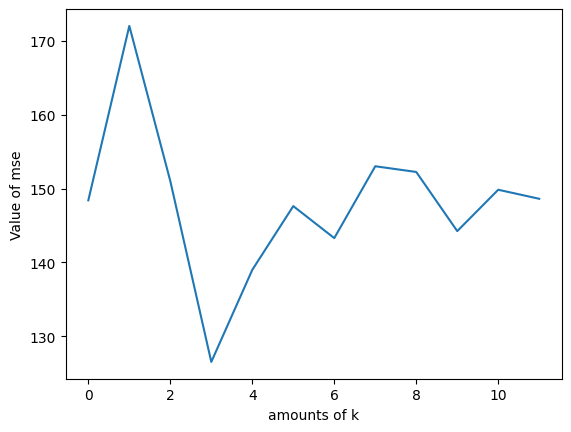

In [ ]:
plt.plot(mse_val_cd1)
plt.xlabel('amounts of k')
plt.ylabel('Value of mse')
plt.show()

In [ ]:
model_cd1 = KNeighborsRegressor(n_neighbors = 4)
model_cd1.fit(x1_cd1, y1_cd1)

pred_cd1_knn=model_cd1.predict(x1_cd1)

mse_cd1_knn = mean_squared_error(y1_cd1, pred_cd1_knn)
mae_cd1_knn=abs(pred_cd1_knn-y1_cd1).mean()
rmse_cd1_knn = mean_squared_error(check_table_cd1['QY_red_%'], pred_cd1_knn,squared=False)
r_sq_cd1_knn = model_cd1.score(x1_cd1, y1_cd1)

print(f'coefficient of determination:{r_sq_cd1_knn:.2f}')
print(f'MSE {mse_cd1_knn:.1f}')
print(f'RMSE {rmse_cd1_knn:.1f}')
print(f'MAE {mae_cd1_knn}')

x1_new = [[0.520833, 3.333333	, 180, 8]]  # New set of features for prediction
pred_FL1_cd1 = model_cd1.predict(x1_new)
print(pred_FL1_cd1)

coefficient of determination:0.15
MSE 126.5
RMSE 11.2
MAE 9.799999999999999
[19.96]


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KNeighborsRegressor was fitted with feature names
  warnings.warn(


In [ ]:
#for CA and formamide

check_table2 = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['reagent'] == 'formamide') & (train_df['time_h'] > 2)]
check_table2

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
8,10.1021/acsnano.7b06399,ST,CA,urea,NaN,formamide,1.0,1.00,NaN,15.0,NaN,180.0,12.0,530.0,550.0,630,4.00,0.347222,1.111111,NaN
11,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.2,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,627,53.10,0.078125,0.393750,NaN
12,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.6,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,51.60,0.104167,0.393750,NaN
13,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.8,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,630,37.40,0.052083,0.393750,NaN
14,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.4,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,18.30,0.026042,0.393750,NaN
20,10.1021/acsami.8b19042,ST,CA,PEI,NaN,formamide,10.0,6.30,NaN,200.0,NaN,160.0,4.0,540.0,550.0,640,NaN,0.260417,0.525000,NaN
37,10.1002/anie.202007786,ST,CA,PEI,NaN,formamide,7.5,4.70,NaN,150.0,NaN,160.0,4.0,540.0,550.0,635,NaN,0.260417,0.220657,NaN
39,10.1016/j.saa.2020.118230,ST,CA,acrylamide,NaN,formamide,1.0,2.00,NaN,10.0,NaN,200.0,4.0,550.0,560.0,644,NaN,0.520833,2.816901,NaN
73,10.1016/j.microc.2022.107350,ST,CA,ethylenediamine,NaN,formamide,1.2,1.90,NaN,80.0,NaN,180.0,4.0,560.0,550.0,610,15.44,0.078125,0.527778,NaN
76,10.1016/j.saa.2020.118230,ST,CA,acrylamide,NaN,formamide,1.0,2.00,NaN,10.0,NaN,200.0,4.0,550.0,560.0,644,NaN,0.520833,2.816901,NaN


In [ ]:
check_table_QY2= check_table2.loc[(check_table2['QY_red_%'].notnull())]

# Obtaining unique attribute values
#unique_values = check_table_QY2['power_W'].unique()

# Checking each value and removing rows where it occurs only once
#for value in unique_values:
 #   if len(check_table_QY2[check_table_QY2['power_W'] == value]) == 1:
 #       check_table_QY2= check_table_QY2[check_table_QY2['power_W'] != value]

check_table_QY2

,DOI,type_of_synthesis,precursor_1,precursor_2,precursor_3,reagent,precursor_1_g,precursor_2_g,precursor_3_g,reagent_mL,power_W,temperature_°C,time_h,Abs_red_max_nm,Exc_red_max_nm,FL_red_max_nm,QY_red_%,molar_concentration_precursor_1,molar_concentration_precursor_2,molar_concentration_precursor_3
8,10.1021/acsnano.7b06399,ST,CA,urea,NaN,formamide,1.0,1.00,NaN,15.0,NaN,180.0,12.0,530.0,550.0,630,4.00,0.347222,1.111111,NaN
11,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.2,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,627,53.10,0.078125,0.393750,NaN
12,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,1.6,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,51.60,0.104167,0.393750,NaN
13,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.8,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,630,37.40,0.052083,0.393750,NaN
14,10.1021/acs.langmuir.7b02385,ST,CA,ethylenediamine,NaN,formamide,0.4,1.89,NaN,80.0,NaN,180.0,4.0,564.0,561.0,624,18.30,0.026042,0.393750,NaN
73,10.1016/j.microc.2022.107350,ST,CA,ethylenediamine,NaN,formamide,1.2,1.90,NaN,80.0,NaN,180.0,4.0,560.0,550.0,610,15.44,0.078125,0.527778,NaN
77,10.1021/acsami.0c01972,ST,CA,p-phenylenediamine,phytic acid,formamide,1.2,0.50,0.7,80.0,NaN,180.0,4.0,570.0,550.0,620,21.00,0.078125,0.057870,0.013258


In [ ]:
x3= check_table_QY2[['molar_concentration_precursor_1','temperature_°C','time_h']]
y3 = check_table_QY2['QY_red_%']

regrQY3 = linear_model.LinearRegression()
regrQY3.fit(x3, y3)

coefficients3 = regrQY3.coef_
intercept3 = regrQY3.intercept_


pred3=regrQY3.predict(x3)

mse3 = mean_squared_error(y3, pred3)
mae3=abs(pred3-y3).mean()
rmse3 = mean_squared_error(check_table_QY2['QY_red_%'], pred3,squared=False)
r_sq3 = regrQY3.score(x3, y3)

print(f'coefficient of determination:{r_sq3:.1f}')
print(f'MSE {mse3:.1f}')
print(f'RMSE {rmse3:.1f}')
print(f'MAE {mae3:.1f}')

# Print regression equation
equation_QY3 = 'y = '
for i, coef in enumerate(coefficients3):
    equation_QY3 += f'({coef:.2f} * x{i+1}) + '
equation_QY3 += f'{intercept3:.2f}'
print(equation_QY3)

x3_new = [[0.520833333, 190, 8]]  # New set of features for prediction
pred_QY3 = regrQY3.predict(x3_new)
print(pred_QY3)

coefficient of determination:0.5
MSE 155.3
RMSE 12.5
MAE 10.2
y = (311.14 * x1) + (0.00 * x2) + (-14.40 * x3) + 68.82
[115.63333309]


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [ ]:
#doing optimization for synthesis 2
from scipy.optimize import minimize

# Function for optimization
def negative_prediction(x):
    return -regrQY3.predict([x])[0]

# Getting the minimum and maximum values of features
min_values = x3.min()
max_values = x3.max()

# Restrictions on feature values
bounds = [(min_val, max_val) for min_val, max_val in zip(min_values, max_values)]

# Initial values for optimization (you can take average values)
initial_values = [(b[0] + b[1]) / 2 for b in bounds]

# Perform optimization
result = minimize(negative_prediction, initial_values, bounds=bounds)

# Optimal feature values
optimal_values = result.x
optimal_prediction = -result.fun

print("Optimal Feature Values:", optimal_values)
print("Optimal Prediction:", optimal_prediction)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


Optimal Feature Values: [  0.34722222 180.           4.        ]
Optimal Prediction: 119.23333310077328


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [ ]:
# Define the models
models = [
    ('Ridge', Ridge(alpha=0.1)),
    ('Lasso', Lasso(alpha=0.1)),
    ('ElasticNet', ElasticNet(alpha=0.1))
]

# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])

    # Fit the model
    pipeline.fit(x3, y3)

    # Make predictions
    pred = pipeline.predict(x3)

    # Calculate metrics
    rmse = mean_squared_error(check_table_QY2['FL_red_max_nm'], pred, squared=False)
    mae = mean_absolute_error(check_table_QY2['FL_red_max_nm'], pred)
    coef_of_determination = pipeline.score(x3, y3)

    # Get coefficients and intercept
    coefficients = pipeline.named_steps['model'].coef_
    intercept = pipeline.named_steps['model'].intercept_

    # Print metrics
    print(f"Model: {model_name}")
    print(f"RMSE: {rmse}")
    print(f"MAE: {mae}")
    print(f"Coefficient of determination: {coef_of_determination:.3f}")

    # Print equation
    equation = 'y = '
    for i, coef in enumerate(coefficients):
        equation += f'({coef:.2f} * x{i+1}) + '
    equation += f'{intercept:.2f}'
    print(f"Equation: {equation}")
    print()



# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])


    # Make predictions on x1_new
    pred_pipeline = pipeline.predict(x3_new)

    # Print the predictions
    print(f"Model: {model_name}")
    print(f"Predictions: {pred_pipeline}")
    print()

Model: Ridge
RMSE: 595.0451017868501
MAE: 594.88
Coefficient of determination: 0.342
Equation: y = (10.73 * x1) + (0.00 * x2) + (-3.97 * x3) + 47.92

Model: Lasso
RMSE: 595.0556651742718
MAE: 594.8800000000001
Coefficient of determination: 0.426
Equation: y = (110.68 * x1) + (0.00 * x2) + (-7.43 * x3) + 54.83

Model: ElasticNet
RMSE: 595.0432318115152
MAE: 594.88
Coefficient of determination: 0.333
Equation: y = (2.03 * x1) + (0.00 * x2) + (-3.64 * x3) + 47.20

Model: Ridge
Predictions: [21.77641159]

Model: Lasso
Predictions: [53.02841945]

Model: ElasticNet
Predictions: [19.12328212]



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but Ridge was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but Lasso was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but ElasticNet was fitted with feature names
  warnings.warn(


In [ ]:
check_table2 = train_df.loc[(train_df['precursor_1'] == 'CA') & (train_df['reagent'] == 'formamide') & (train_df['time_h'] > 0)]

check_table_cd2= check_table2.loc[(check_table2['QY_red_%'].notnull())]

x2_cd2= check_table_cd2[['molar_concentration_precursor_1','temperature_°C','time_h']]
y2_cd2 = check_table_cd2['QY_red_%']

In [ ]:
mse_val_cd2 = [] #to store rmse values for different k
for K in range(10):
    K = K+1
    model_cd2 = KNeighborsRegressor(n_neighbors = K)

    model_cd2.fit(x2_cd2, y2_cd2)  #fit the model
    pred_cd2=model_cd2.predict(x2_cd2) #make prediction on set
    error_cd2 = mean_squared_error(y2_cd2,pred_cd2) #calculate rmse
    mse_val_cd2.append(error_cd2) #store rmse values
    print('MSE value for k=' , K , 'is:', error_cd2)

MSE value for k= 1 is: 244.86856000000003
MSE value for k= 2 is: 165.96382000000003
MSE value for k= 3 is: 238.9752577777778
MSE value for k= 4 is: 225.87816249999997
MSE value for k= 5 is: 247.77454079999993
MSE value for k= 6 is: 247.41093777777778
MSE value for k= 7 is: 236.6561510204082
MSE value for k= 8 is: 240.94146687499997
MSE value for k= 9 is: 234.9377590123457
MSE value for k= 10 is: 228.67422399999995


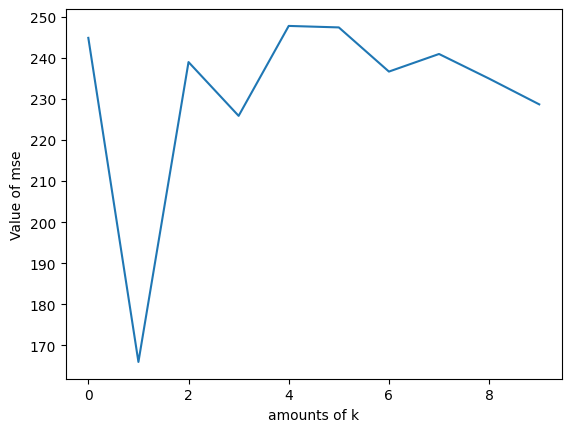

In [ ]:
plt.plot(mse_val_cd2)
plt.xlabel('amounts of k')
plt.ylabel('Value of mse')
plt.show()

In [ ]:
model_cd2 = KNeighborsRegressor(n_neighbors = 2)
model_cd2.fit(x2_cd2, y2_cd2)

pred_cd2_knn=model_cd2.predict(x2_cd2)

mse_cd2_knn = mean_squared_error(y2_cd2, pred_cd2_knn)
mae_cd2_knn=abs(pred_cd2_knn-y2_cd2).mean()
rmse_cd2_knn = mean_squared_error(check_table_cd2['QY_red_%'], pred_cd2_knn,squared=False)
r_sq_cd2_knn = model_cd2.score(x2_cd2, y2_cd2)

print(f'coefficient of determination:{r_sq_cd2_knn:.2f}')
print(f'MSE {mse_cd2_knn:.1f}')
print(f'RMSE {rmse_cd2_knn:.1f}')
print(f'MAE {mae_cd2_knn}')

x2_new = [[0.520833333, 190, 1]]  # New set of features for prediction
pred_FL_cd2 = model_cd2.predict(x2_new)
print(pred_FL_cd2)

coefficient of determination:0.27
MSE 166.0
RMSE 12.9
MAE 9.958
[52.35]


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but KNeighborsRegressor was fitted with feature names
  warnings.warn(


***THE BELOW IS THE DRAFT NOTES ***

In [ ]:
# Define the models
models = [
    ('Ridge', Ridge(alpha=0.1)),
    ('Lasso', Lasso(alpha=0.1)),
    ('ElasticNet', ElasticNet(alpha=0.1))
]

# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])

    # Fit the model
    pipeline.fit(x4, y4)

    # Make predictions
    pred = pipeline.predict(x4)

    # Calculate metrics
    rmse = mean_squared_error(check_table2['FL_red_max_nm'], pred, squared=False)
    mae = mean_absolute_error(check_table2['FL_red_max_nm'], pred)
    coef_of_determination = pipeline.score(x4, y4)

    # Get coefficients and intercept
    coefficients = pipeline.named_steps['model'].coef_
    intercept = pipeline.named_steps['model'].intercept_

    # Print metrics
    print(f"Model: {model_name}")
    print(f"RMSE: {rmse}")
    print(f"MAE: {mae}")
    print(f"Coefficient of determination: {coef_of_determination:.3f}")

    # Print equation
    equation = 'y = '
    for i, coef in enumerate(coefficients):
        equation += f'({coef:.2f} * x{i+1}) + '
    equation += f'{intercept:.2f}'
    print(f"Equation: {equation}")
    print()


# Create a pipeline for each model
for model_name, model in models:
    pipeline = Pipeline([
        ('model', model)
    ])


    # Make predictions on x1_new
    pred_pipeline = pipeline.predict(x4_new)

    # Print the predictions
    print(f"Model: {model_name}")
    print(f"Predictions: {pred_pipeline}")
    print()

NameError: name 'x4' is not defined

In [ ]:
#from sklearn.cluster import DBSCAN

# Clustering with DBSCAN
#dbscan = DBSCAN(eps=50, min_samples=3)
#labels = dbscan.fit_predict(X)


#fig, ax = plt.subplots(figsize=(15, 15), subplot_kw={'projection': '3d'})

#scatter = ax.scatter(X['QY_red_%'], X['Abs_red_max_nm'], X['FL_red_max_nm'], c=labels, cmap='viridis')

#ax.set_xlabel('QY_red_%')
#ax.set_ylabel('Abs_red_max_nm')
#ax.set_zlabel('FL_red_max_nm')

#for i, row in X.iterrows():
   # ax.text(row['QY_red_%'], row['Abs_red_max_nm'], row['FL_red_max_nm'], s=i, fontsize=10)

#legend = ax.legend(*scatter.legend_elements(), title='Clusters')

#ax.add_artist(legend)

#plt.show()


In [ ]:
#Reducing the dimension from 3 to 2
#from sklearn.manifold import TSNE

#model = TSNE(perplexity=4)
#X_TSNE = model.fit_transform(X_new)

#x_axis = X_TSNE[:, 0]
#y_axis = X_TSNE[:, 1]

#plt.scatter(x_axis, y_axis)
#plt.show()

In [ ]:
#Reducing the dimension from 3 to 2
#from sklearn.decomposition import PCA

#model = PCA(n_components=2)
#X_PCA = model.fit_transform(X_new)

#x_axis = X_PCA[:, 0]
#y_axis = X_PCA[:, 1]

#plt.scatter(x_axis, y_axis)
#plt.show()

In [ ]:
from sklearn.cluster import KMeans



# Create an instance of KMeans and train on the data
#kmeans = KMeans(n_clusters=3, random_state=0)
#labels = kmeans.fit_predict(X_PCA)

# Display the resulting clusters on the graph
#x_axis = X_PCA[:, 0]
#y_axis = X_PCA[:, 1]

# Define colors for each cluster
#colors = ['r', 'g', 'b', 'k']

# Draw the points of each cluster in different colors
#for i in range(k):
  #  plt.scatter(x_axis[labels == i], y_axis[labels == i], c=colors[i])

#plt.show()

In [ ]:
from sklearn.cluster import DBSCAN

from sklearn.manifold import TSNE

#eps is the maximum distance between neighboring points, min_samples is the minimum number of points in the neighborhood (number of neighbors) when we can say that these data instances form one cluster.
# Create a DBSCAN instance and set parameters
#dbscan = DBSCAN(eps=100, min_samples=3)

#labels = dbscan.fit_predict(X_PCA)

#colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k']

#for i in range(len(set(labels))):
  #  plt.scatter(X_PCA[labels == i, 0], X_PCA[labels == i, 1], c=colors[i % len(colors)], label=f'Cluster {i+1}')

#plt.legend()
#plt.show()
